<a href="https://colab.research.google.com/github/musab-r/Computational_Intelligence_Project/blob/main/Phase%202%20NN%2C%20FS%2C%20GA/Fuzzy_Systems_Twitter_V2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Computational Intelligence Project: Sentiment Analysis on IMDB dataset Using Fuzzy System on Twitter

Musab - 19030008

Sentiment analysis is one of the key areas of research in NLP and Sequence modelling. I will be using fuzzy systems to predict two classes - positive or negative sentiment. 

In [ ]:
import re
import os
import pandas as pd
import numpy as np
!pip install -U scikit-fuzzy
import skfuzzy as fuzz
import nltk
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import time
from keras.datasets import imdb
import matplotlib.pyplot as plt


     |████████████████████████████████| 1.0MB 11.2MB/s 
  Created wheel for scikit-fuzzy: filename=scikit_fuzzy-0.4.2-cp37-none-any.whl size=894069 sha256=03c75ed98061b6196825bfa4796a5d61908425a62c604aad2fee1370563d3581
  Stored in directory: /root/.cache/pip/wheels/b9/4e/77/da79b16f64ef1738d95486e2731eea09d73e90a72465096600
Successfully built scikit-fuzzy
[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


/usr/local/lib/python3.7/dist-packages/nltk/twitter/__init__.py:20: UserWarning: The twython library has not been installed. Some functionality from the twitter package will not be available.
  warnings.warn("The twython library has not been installed. "


## Loading Dataset

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

# dataset = "twitter-sanders-apple3.csv"
# drive_path = '/content/drive/My Drive/Computational Intelligence/'
# path = os.path.join(drive_path, dataset)
df = pd.read_csv("twitter-sanders-apple3.csv")

In [ ]:
start = time.time()

traindata = df
doc = traindata.text
print(len(doc))
sentidoc = traindata['class']

988


In [ ]:
df.head

<bound method NDFrame.head of        class                                               text
0        Pos  Now all @Apple has to do is get swype on the i...
1        Pos  @Apple will be adding more carrier support to ...
2        Pos  Hilarious @youtube video - guy does a duet wit...
3        Pos  @RIM you made it too easy for me to switch to ...
4        Pos  I just realized that the reason I got into twi...
..       ...                                                ...
983  Neutral  @vlingo is a POOR substitute for Siri!! Yo @AP...
984  Neutral                                @Apple Scrapple. (:
985  Neutral  @tvnewschick @apple Oh no! Why not?! I want it...
986  Neutral  One of the great #entrepreneurs has died. #Ste...
987  Neutral  @fashionNOGuilt haha! tomorrow should be less ...

[988 rows x 2 columns]>

In [ ]:
# Generate variables
x_p = np.arange(0, 1, 0.1)
x_n = np.arange(0, 1, 0.1)
x_op = np.arange(0, 10, 1)

## Membership Functions

In [ ]:
# Generate fuzzy membership functions
p_lo = fuzz.trimf(x_p, [0, 0, 0.5])
p_md = fuzz.trimf(x_p, [0, 0.5, 1])
p_hi = fuzz.trimf(x_p, [0.5, 1, 1])
n_lo = fuzz.trimf(x_n, [0, 0, 0.5])
n_md = fuzz.trimf(x_n, [0, 0.5, 1])
n_hi = fuzz.trimf(x_n, [0.5, 1, 1])
op_Neg = fuzz.trimf(x_op, [0, 0, 5])
op_Neu = fuzz.trimf(x_op, [0, 5, 10])
op_Pos = fuzz.trimf(x_op, [5, 10, 10])

### Visualization of Memvership Functions

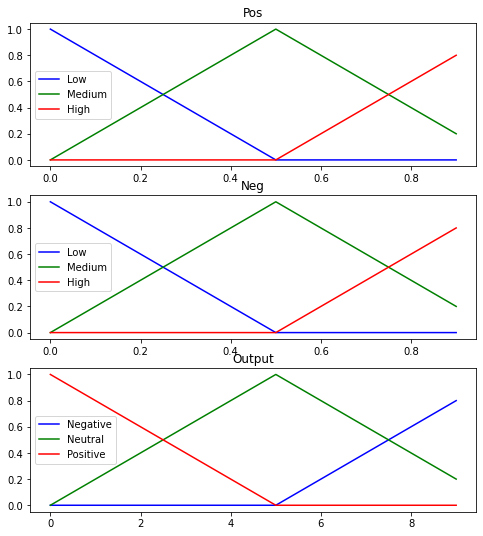

In [ ]:
# Visualize these universes and membership functions
fig, (ax0, ax1, ax2) = plt.subplots(nrows=3, figsize=(8, 9))
#
ax0.plot(x_p, p_lo, 'b', linewidth=1.5, label='Low')
ax0.plot(x_p, p_md, 'g', linewidth=1.5, label='Medium')
ax0.plot(x_p, p_hi, 'r', linewidth=1.5, label='High')
ax0.set_title('Pos')
ax0.legend()

ax1.plot(x_n, n_lo, 'b', linewidth=1.5, label='Low')
ax1.plot(x_n, n_md, 'g', linewidth=1.5, label='Medium')
ax1.plot(x_n, n_hi, 'r', linewidth=1.5, label='High')
ax1.set_title('Neg')
ax1.legend()

ax2.plot(x_op, op_Pos, 'b', linewidth=1.5, label='Negative')
ax2.plot(x_op, op_Neu, 'g', linewidth=1.5, label='Neutral')
ax2.plot(x_op, op_Neg, 'r', linewidth=1.5, label='Positive')
ax2.set_title('Output')
ax2.legend()

## Preprocessing

In [ ]:
tweets=[]
senti=[]
sentiment=[]
sentiment_doc=[]

for j in range(len(doc)):
    str1=traindata.text[j]
    str2=str1.lower()
    tweets.append(str2)   # converted into lower case
    senti.append(traindata['class'][j])

def decontracted(phrase):   # text pre-processing 
        # specific
        phrase = re.sub(r"won't", "will not", phrase)
        phrase = re.sub(r"can\'t", "can not", phrase)
        phrase = re.sub(r"@", "" , phrase)         # removal of @
        phrase =  re.sub(r"http\S+", "", phrase)   # removal of URLs
        phrase = re.sub(r"#", "", phrase)          # hashtag processing
    
        # general
        phrase = re.sub(r"n\'t", " not", phrase)
        phrase = re.sub(r"\'re", " are", phrase)
        phrase = re.sub(r"\'s", " is", phrase)
        phrase = re.sub(r"\'d", " would", phrase)
        phrase = re.sub(r"\'ll", " will", phrase)
        phrase = re.sub(r"\'t", " not", phrase)
        phrase = re.sub(r"\'ve", " have", phrase)
        phrase = re.sub(r"\'m", " am", phrase)
        return phrase
    
for k in range(len(doc)):
    tweets[k]=decontracted(tweets[k])
         
sid = SentimentIntensityAnalyzer()


In [ ]:
len(sentiment_doc), len(sentiment)

(0, 0)

## Output

1 now all apple has to do is get swype on the iphone and it will be crack. iphone that is {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

2 apple will be adding more carrier support to the iphone 4s (just announced) {'neg': 0.0, 'neu': 0.801, 'pos': 0.199, 'compound': 0.4549}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positiv

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 4.79

Output after Defuzzification: Neutral
Doc sentiment: Pos

13 rt philliprowntree: just registered as an apple developer... here is hoping i can actually do it... any help greatly appreciated! {'neg': 0.0, 'neu': 0.63, 'pos': 0.37, 'compound': 0.855}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.87

Output after Defuzzification: Neutral
Doc sentiment: Pos

15 just registered as an apple developer... here is hoping i can actually do it... any help greatly appreciated! {'neg': 0.0, 'neu': 0.599, 'pos': 0.401, 'compound': 0.855}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

17 come to the dark side gretcheneclark: hey apple if you send me a free iphone i will publicly and ceremoniously burn my blackberry. {'neg': 0.0, 'neu': 0.858, 'pos': 0.142, 'compound': 0.5106}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

19 thank you apple for find my mac - just located and wiped my stolen air. smallvictory thievingbastards {'neg': 0.162, 'neu': 0.711, 'pos': 0.127, 'compound': -0.1779}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_hi

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

21 dailydealchat apple thanks!!------------------------------------- {'neg': 0.0, 'neu': 0.365, 'pos': 0.635, 'compound': 0.5399}

Positive Score for each  tweet :
0.6

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated O

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

23 apple..good ipad------------------------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Pos

25 amazing new apple ios 5 feature.  ------------------------------- {'neg': 0.0, 'neu': 0.513, 'pos': 0.487, 'compound': 0.5859}

Positive Score for each  tweet :
0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

27 we are one of a few featured education apps on the apple **website** today sweet!  {'neg': 0.0, 'neu': 0.798, 'pos': 0.202, 'compound': 0.5093}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Pos

29 we did an unexpected workshop for the iphone4s at apple yesterday and we got an awesome amount of info notjustaboutthephone gamerchik16 {'neg': 0.0, 'neu': 0.83, 'pos': 0.17, 'compound': 0.6249}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

31 --- rt apple no question bro. rt ainteeentrippin: should i get dis iphone or a evo 3d? {'neg': 0.136, 'neu': 0.864, 'pos': 0.0, 'compound': -0.296}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.2 0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.12

Output after Defuzzification: Neutral
Doc sentiment: Pos

33 i am over people bitching about the iphone4s... i think it is the smartest phone i have ever had and i am very happy.   :)  way to go apple! {'neg': 0.061, 'neu': 0.606, 'pos': 0.334, 'compound': 0.8876}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

35 at the bus with my iphone ;) thxx apple-------------------------- {'neg': 0.0, 'neu': 0.808, 'pos': 0.192, 'compound': 0.2263}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated O

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

37 nytimes: coach wants to see you. and bring your ipad.  ipad apple set red 42 red 42 hut hut nfl wish i had an ipad {'neg': 0.0, 'neu': 0.895, 'pos': 0.105, 'compound': 0.4019}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_hi

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

39 bkad5161 than apologize to apple ;)------------------------------ {'neg': 0.0, 'neu': 0.548, 'pos': 0.452, 'compound': 0.3182}

Positive Score for each  tweet :
0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated O

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

41 lmfao look at the argument i had with siri !!ijustine apple ----- {'neg': 0.171, 'neu': 0.549, 'pos': 0.28, 'compound': 0.3786}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

43 save me from hp is unwanted os! help me buy an iphone! i have seen the light! lol  backchannel apple {'neg': 0.072, 'neu': 0.567, 'pos': 0.362, 'compound': 0.826}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.2 0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.12

Output after Defuzzification: Neutral
Doc sentiment: Pos

45 currently ordering a brand new macbook pro!!! bahhh... my macbook is 5 years old. i will miss it. but it is time. cc: apple - {'neg': 0.098, 'neu': 0.902, 'pos': 0.0, 'compound': -0.2905}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Pos

47 siri now knows who my dad mom brother and girlfriend is.  thanks apple {'neg': 0.0, 'neu': 0.805, 'pos': 0.195, 'compound': 0.4404}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggreg

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.87

Output after Defuzzification: Neutral
Doc sentiment: Pos

49 sweet... apple replaced my glass probono. thank you apple-------- {'neg': 0.0, 'neu': 0.762, 'pos': 0.238, 'compound': 0.3612}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Ag

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

51 loving new technology from apple iphone 4s mac air and icloud are unreal technology {'neg': 0.0, 'neu': 0.769, 'pos': 0.231, 'compound': 0.5994}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Pos

53 another mention for apple store:  - rt floridamike once again getting great customer service from the apple store ... {'neg': 0.0, 'neu': 0.806, 'pos': 0.194, 'compound': 0.6249}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

54 time to go get my iphone 4s.  looking forward to sticking it to the man by no longer paying for most texts.  thanks apple. {'neg': 0.08, 'neu': 0.804, 'pos': 0.116, 'compound': 0.2449}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Pos

56 thank you apple. my new gf(iphone4s) is great!  she does everything! {'neg': 0.0, 'neu': 0.556, 'pos': 0.444, 'compound': 0.8011}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Pos

58 wisconsin_mommy apple i would totally email the company... i always get great service at our apple store! {'neg': 0.0, 'neu': 0.761, 'pos': 0.239, 'compound': 0.6588}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

60 the nice apple tech support guy fixed my itouch =d--------------- {'neg': 0.0, 'neu': 0.443, 'pos': 0.557, 'compound': 0.8316}

Positive Score for each  tweet :
0.6

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated O

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

62 is it just me or is ios5 faster for the ipad? apple-------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Pos

64 making the switch from android to apple iphone iphone4s smartphone stevejobs ( apple store)  {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

66 play on ma man. loving the camera in the iphone4s. well done apple  fb  {'neg': 0.0, 'neu': 0.567, 'pos': 0.433, 'compound': 0.8126}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

68 apple safari reader owns the worldwide web----------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

70 10twitterpeopleiwouldliketomeet coollike thegadgetshow  thelittleappkid jon4lakers benrubery apple twitter fxhomehitfilm  (-2) {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activati

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

72 kind of excited. on my way to my last class right now and then going to the apple store so buy macosc snow leopard and lion :-) {'neg': 0.0, 'neu': 0.842, 'pos': 0.158, 'compound': 0.5719}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Pos

74 apple sells 4 million iphones in 3 days apple keep doing what you are doing because you are doing it well!  {'neg': 0.0, 'neu': 0.883, 'pos': 0.117, 'compound': 0.3382}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

76 4 millions in a weekend 16 iphone4s per second. this is madness?! no this is apple !!! {'neg': 0.194, 'neu': 0.806, 'pos': 0.0, 'compound': -0.5216}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

78 iancollinsuk apple i like what you did there...!----------------- {'neg': 0.0, 'neu': 0.682, 'pos': 0.318, 'compound': 0.4199}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated O

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

80 sorry blackberry i am moving to apple.--------------------------- {'neg': 0.206, 'neu': 0.794, 'pos': 0.0, 'compound': -0.0772}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

A

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

82 laundering ari is iphone not my finest moment. but after drying in bag of (organic :-) rice for 4 days it booted up!!!!!!!!!!! apple {'neg': 0.0, 'neu': 0.842, 'pos': 0.158, 'compound': 0.6271}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

84 god bless youtube apple for  appletv & our bad ass system. loving princessofchina. gb to coldplay & rihanna too :) {'neg': 0.0, 'neu': 0.417, 'pos': 0.583, 'compound': 0.9413}

Positive Score for each  tweet :
0.6

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

86 thank you apple ios 5 for email pop up on the lock screen and opening it when unlocking. {'neg': 0.0, 'neu': 0.865, 'pos': 0.135, 'compound': 0.3612}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

88 this good here iphone will do me very well today. thanks to the gods that are apple. {'neg': 0.0, 'neu': 0.623, 'pos': 0.377, 'compound': 0.8155}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

90 love ios5 easter eggs. pull down from middle top to bottom and see what pulls down. awesome little feature! ios5 apple {'neg': 0.0, 'neu': 0.634, 'pos': 0.366, 'compound': 0.8858}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activatio

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.87

Output after Defuzzification: Neutral
Doc sentiment: Pos

92 updated my ios and started using cloud services. pretty bad ass apple my iphone 3gs still the champ. {'neg': 0.0, 'neu': 0.553, 'pos': 0.447, 'compound': 0.8834}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Pos

94 apple your simply the best.-------------------------------------- {'neg': 0.0, 'neu': 0.488, 'pos': 0.512, 'compound': 0.6369}

Positive Score for each  tweet :
0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

96 day305 i am thankful for the great customer service received today from apple via phone cs new phone on the way 365daysofgratefulness {'neg': 0.0, 'neu': 0.709, 'pos': 0.291, 'compound': 0.8316}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

98 loving the new ipod update apple--------------------------------- {'neg': 0.0, 'neu': 0.562, 'pos': 0.438, 'compound': 0.5994}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Ag

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Pos

100 rt tomkeene thx instagram thx apple hypo d-76 tri-x ------------- {'neg': 0.0, 'neu': 0.583, 'pos': 0.417, 'compound': 0.6124}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.2 0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.12

Output after Defuzzification: Neutral
Doc sentiment: Pos

102 thx instagram thx apple hypo d-76 tri-x ------------------------- {'neg': 0.0, 'neu': 0.5, 'pos': 0.5, 'compound': 0.6124}

Positive Score for each  tweet :
0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggre

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Pos

104 i love this. so much. thank you apple.  ------------------------- {'neg': 0.0, 'neu': 0.417, 'pos': 0.583, 'compound': 0.7893}

Positive Score for each  tweet :
0.6

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.87

Output after Defuzzification: Neutral
Doc sentiment: Pos

106 apple cards app notifies me the card i sent has arrived at local post office and should be delivered today... sunday. truly is magic. {'neg': 0.0, 'neu': 0.884, 'pos': 0.116, 'compound': 0.4404}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Pos

108 apple siri is amazing-------------------------------------------- {'neg': 0.0, 'neu': 0.441, 'pos': 0.559, 'compound': 0.5859}

Positive Score for each  tweet :
0.6

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

A

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

110 meet siri your new iphone butler. click the link and be amazed by all it can do:  apple {'neg': 0.0, 'neu': 0.842, 'pos': 0.158, 'compound': 0.4939}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Pos

112 i  apple -------------------------------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

114 loving ios5 !! awesome apple------------------------------------- {'neg': 0.0, 'neu': 0.259, 'pos': 0.741, 'compound': 0.8619}

Positive Score for each  tweet :
0.7

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

116 thank you apple for your innovations. exhibit a: guy playing with facetime instead of watching game at sports bar.  {'neg': 0.0, 'neu': 0.798, 'pos': 0.202, 'compound': 0.5106}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

118 apple by far the best ipod and first time iphone ever.... good job guys {'neg': 0.0, 'neu': 0.628, 'pos': 0.372, 'compound': 0.7964}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggre

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

120 apple is siri is witchcraft.  what is next googleresearch. 2 yr lead lost? {'neg': 0.173, 'neu': 0.827, 'pos': 0.0, 'compound': -0.3182}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

122 rt katebetts: another great james stewart story in today is ny times about importance of architecture in apple retail success  ... {'neg': 0.0, 'neu': 0.636, 'pos': 0.364, 'compound': 0.8834}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.87

Output after Defuzzification: Neutral
Doc sentiment: Pos

124 i &lt;3 apple --------------------------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Pos

126 impressive service apple genius bar metro centre. power cable replaced free n booked in for screen replacement for free :- d {'neg': 0.0, 'neu': 0.618, 'pos': 0.382, 'compound': 0.872}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_act

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

128 the nice guy at the apple store replaced my phone gratis when i showed him the hairline  crack on the screen. thanks apple {'neg': 0.0, 'neu': 0.734, 'pos': 0.266, 'compound': 0.7096}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_acti

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

130 it would have taken me 15 mins to write this with my blackberry. thank u apple 4s for converting me and showing me the grass is greener! {'neg': 0.0, 'neu': 0.9, 'pos': 0.1, 'compound': 0.4199}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

132 rickysinghpt got a new backside for my eye phone! v impressed with apple {'neg': 0.0, 'neu': 0.747, 'pos': 0.253, 'compound': 0.5255}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Pos

134 thank you apple for making my ipad 2 feel like new again with your new ios 5! {'neg': 0.0, 'neu': 0.726, 'pos': 0.274, 'compound': 0.6476}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

136 using my awsome ipad... i love it. i love my macbook too and my ipod. it is all amazing! i love apple {'neg': 0.0, 'neu': 0.473, 'pos': 0.527, 'compound': 0.9565}

Positive Score for each  tweet :
0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

138 new ios 5 update is the best. iloveyou apple--------------------- {'neg': 0.0, 'neu': 0.625, 'pos': 0.375, 'compound': 0.6369}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

A

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Pos

140 i absolutely love my iphone 4s. thank you steve and apple.------- {'neg': 0.0, 'neu': 0.534, 'pos': 0.466, 'compound': 0.7902}

Positive Score for each  tweet :
0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

A

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

142 dammit listening to siri is making me want to upgrade. well played apple. {'neg': 0.0, 'neu': 0.633, 'pos': 0.367, 'compound': 0.5859}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

144 video card on kimaris workstation died after just six months. so long hp. hello apple. {'neg': 0.205, 'neu': 0.795, 'pos': 0.0, 'compound': -0.5574}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

146 ios5 update submitted to apple! thanks for all the support!------ {'neg': 0.0, 'neu': 0.564, 'pos': 0.436, 'compound': 0.7339}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Pos

148 rt to1ne: .apple thanks for fixing this... ---------------------- {'neg': 0.0, 'neu': 0.674, 'pos': 0.326, 'compound': 0.4404}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 4.79

Output after Defuzzification: Neutral
Doc sentiment: Pos

150 .apple thanks for fixing this... -------------------------------- {'neg': 0.0, 'neu': 0.58, 'pos': 0.42, 'compound': 0.4404}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Pos

152 rt sawyerhartman: i fu*king love you apple this phone is the best thing ever !! siri = best thing ever made {'neg': 0.0, 'neu': 0.548, 'pos': 0.452, 'compound': 0.9347}

Positive Score for each  tweet :
0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Pos

154 mad props to the apple employee that did not charge me to replace the back plate on my iphone! made my day! {'neg': 0.153, 'neu': 0.847, 'pos': 0.0, 'compound': -0.5837}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Pos

156 the iphone4s is  amazing. siri is voice recognition is absolutely a step above previous attempts. bravo apple {'neg': 0.0, 'neu': 0.798, 'pos': 0.202, 'compound': 0.5859}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Pos

158 ios5 is nice and as it had to be ! thanks apple------------------ {'neg': 0.0, 'neu': 0.6, 'pos': 0.4, 'compound': 0.7177}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggre

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Pos

160 just downloaded ios 5. it is better than i expected! thankyou apple {'neg': 0.0, 'neu': 0.758, 'pos': 0.242, 'compound': 0.4926}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregat

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Pos

162 apple: siri is amazing!!! i am in love!-------------------------- {'neg': 0.0, 'neu': 0.353, 'pos': 0.647, 'compound': 0.8798}

Positive Score for each  tweet :
0.6

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Defuzzified Output: 7.6

Output after Defuzzification: Positive
Doc sentiment: Pos

164 rt cjwallace03: so apparently apple put mb cap on your sms with the new update. 25mb storage before it tells you your inbox is full. w ... {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activ

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neg

166 mashable apple iphones r 2 expensive. most went w/ htc/galaxy. no customer loyalty w/phone comp.. {'neg': 0.132, 'neu': 0.659, 'pos': 0.21, 'compound': 0.3182}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activati

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neg

168 apple why my tunes no go on my iphone? iphone lonely without them. silly ios5 {'neg': 0.325, 'neu': 0.675, 'pos': 0.0, 'compound': -0.5823}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

170 why is  siri always down apple----------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

172 apple airdrop fail - immediate declined your request. every time- {'neg': 0.304, 'neu': 0.696, 'pos': 0.0, 'compound': -0.5423}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

174 rt radlerc: yellowgate? some iphone 4s users complain of yellow tint to screen  apple iphone4s {'neg': 0.152, 'neu': 0.848, 'pos': 0.0, 'compound': -0.3612}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

176 the one iphone feature still missing since apple first showed it.. contacts pictures on the contacts list! simple yet 5 major updates miss {'neg': 0.17, 'neu': 0.83, 'pos': 0.0, 'compound': -0.4753}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Neg

178 paulens it surprises me that apple throws up an error alert about authorizing and there is no authorize this computer button. {'neg': 0.188, 'neu': 0.654, 'pos': 0.158, 'compound': -0.2023}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

180 fuck you apple die in a fucking blaze inferno.------------------- {'neg': 0.552, 'neu': 0.448, 'pos': 0.0, 'compound': -0.8126}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.6

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neg

182 omg apple why the fuck did you delete all my music you dicks----- {'neg': 0.226, 'neu': 0.774, 'pos': 0.0, 'compound': -0.5423}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

184 seriously - i have absolutely no offing clue what apple means by authorization nor how to do it. {'neg': 0.23, 'neu': 0.77, 'pos': 0.0, 'compound': -0.4927}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

186 shit shit shit. ios5 update ate all my apps data and media just like apple said it would. this is going to take some time to rebuild. {'neg': 0.298, 'neu': 0.634, 'pos': 0.069, 'compound': -0.8519}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

188 love apple downloads. 4 hours and i-pad now wonky! ripstevejobs thenonsensepersists neednewipadguide fatfuckingchance {'neg': 0.0, 'neu': 0.71, 'pos': 0.29, 'compound': 0.6696}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

190 i am so done with att and apple  is profitering and lack of customer service so fucking down with both!!! {'neg': 0.15, 'neu': 0.85, 'pos': 0.0, 'compound': -0.4898}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_ac

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Neg

192 apple thank you for ruining my 3gs with ios5. you have just turned my phone into an utterly useless pile of shit. {'neg': 0.298, 'neu': 0.617, 'pos': 0.086, 'compound': -0.7346}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

194 so apparently apple put mb cap on your sms with the new update. 25mb storage before it tells you your inbox is full. what is this 2001? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
o

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

196 removing all apple shit.----------------------------------------- {'neg': 0.545, 'neu': 0.455, 'pos': 0.0, 'compound': -0.5574}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.5

Firing Strength of Negative (wneg): 1.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

198 what??? i that sucks hello apple rt phonedog_aaron interesting note - droid razr is battery is not removable. {'neg': 0.127, 'neu': 0.709, 'pos': 0.164, 'compound': 0.1877}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

200 gotta say the apple itouch iphone shuffle etc.. sound quality is awful.. painfully crap. its been a downgrade from sony sound quality wise {'neg': 0.214, 'neu': 0.676, 'pos': 0.11, 'compound': -0.4404}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neg

202 mayati i think apple did not do such a thorough job with the step x steps for upgrade and move to icloud. now it is cost me mightily. {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

204 nickthefnicon he can send but not rcve txts so he has an apt apple at 4pm.then he exclaims: and i waited a whole year for this phone!!lmao {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activ

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

206 fishmama: if you made a purchase just wait for the apple survey! hate going b/c of the bad custserv {'neg': 0.319, 'neu': 0.681, 'pos': 0.0, 'compound': -0.8172}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activa

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.2 0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.12

Output after Defuzzification: Neutral
Doc sentiment: Neg

208 phxguy88 apple bgr that is why all the ppl who stand in line for hrs to get the newest model are suckers... {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

210 apple wow motorola just crushed your dreams....------------------ {'neg': 0.241, 'neu': 0.431, 'pos': 0.328, 'compound': 0.25}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

212 oh just fuck you apple. already?? ---&gt;  iphone 5 on schedule for summer launch?  via bgr {'neg': 0.224, 'neu': 0.776, 'pos': 0.0, 'compound': -0.6174}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

214 wtf?!?! apple the new ios 5 does not allow you not to get push notifications from newstand? and siri just keeps yapping fuck! {'neg': 0.353, 'neu': 0.647, 'pos': 0.0, 'compound': -0.8855}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.4

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

216 steelo254 yea! i pre-order through apple and they sorry too just like at&t {'neg': 0.092, 'neu': 0.71, 'pos': 0.198, 'compound': 0.3595}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

218 apple why is my iphone battery so crappy fail-------------------- {'neg': 0.545, 'neu': 0.455, 'pos': 0.0, 'compound': -0.8553}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.5

Firing Strength of Negative (wneg): 1.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neg

220 why does not apple icloud sync stickies? they have always been around just nothing every progressed w/ them!! why apple why?  gruber {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_a

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

222 i hate my apple computer.  thats 3500 dollars down the drain.---- {'neg': 0.291, 'neu': 0.709, 'pos': 0.0, 'compound': -0.5719}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

224 apple ios5 gm on ipad1 is very slow wash better on beta7/8 solve this problem or give me the ipad2 {'neg': 0.125, 'neu': 0.678, 'pos': 0.198, 'compound': 0.2116}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

226 apple itunes is the worst program ever. for such a great phone you make some awful software. {'neg': 0.293, 'neu': 0.537, 'pos': 0.169, 'compound': -0.4588}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neg

228 apple $319 to repair my ipad 2 apple you have lost me and my $700 a year android here i come! {'neg': 0.132, 'neu': 0.868, 'pos': 0.0, 'compound': -0.3802}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

230 asimrang apple umber the desktop app is wack though-------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

232 frustrated that i bought a new macbook pro from apple only to find it doesnt ship with media! expensivepaperweight {'neg': 0.187, 'neu': 0.813, 'pos': 0.0, 'compound': -0.5707}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neg

234 dontbemadatmebecause android is by far better than apple--------- {'neg': 0.0, 'neu': 0.707, 'pos': 0.293, 'compound': 0.4404}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

A

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

236 apple apple one thing i hater about this mouse the buttery finish so fast am not happy now macworld macworld  {'neg': 0.254, 'neu': 0.746, 'pos': 0.0, 'compound': -0.7002}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activa

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

238 only thing bad about the new canon camera is that it has two compact flash cards... not one of sd. sd goes in my apple computer. damn you! {'neg': 0.2, 'neu': 0.8, 'pos': 0.0, 'compound': -0.7574}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

240 fuck u apple----------------------------------------------------- {'neg': 0.778, 'neu': 0.222, 'pos': 0.0, 'compound': -0.5423}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.8

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

242 why the fuck dose my phone decide its just ganna freeze every time i try to update it so fucking sick of apple {'neg': 0.267, 'neu': 0.689, 'pos': 0.044, 'compound': -0.8004}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_act

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

244 imessage does not show the time a message was sent annoying apple {'neg': 0.213, 'neu': 0.787, 'pos': 0.0, 'compound': -0.4019}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

246 rt circustk: i am wit chu!! shaydiddy: officially boycotting ups!!! calling apple to curse them out next for using them wasting my t ... {'neg': 0.346, 'neu': 0.654, 'pos': 0.0, 'compound': -0.877}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

248 samsung seeks iphone 4s ban in japan and australiapatent war intensifies with injunction sought against apple  {'neg': 0.349, 'neu': 0.651, 'pos': 0.0, 'compound': -0.8176}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activ

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

250 apple ios.5 has been nothing but a pain in the ass no room for my music.. or photos.. or apps! can i undo this garbage?? {'neg': 0.258, 'neu': 0.63, 'pos': 0.112, 'compound': -0.6857}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

252 rt reddeersteph: joelplane apple i hear you! i have had trouble with my 3 & now 4. i have even turned down brightness. andshuttingdownru ... {'neg': 0.127, 'neu': 0.763, 'pos': 0.11, 'compound': -0.1007}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

254 albertmal88 remember apple is evil. icloud entering the dropbox market {'neg': 0.328, 'neu': 0.672, 'pos': 0.0, 'compound': -0.6597}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

256 9% now on my second full charge of the day. pissed apple--------- {'neg': 0.276, 'neu': 0.724, 'pos': 0.0, 'compound': -0.6369}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

258 i am wit chu!! shaydiddy: officially boycotting ups!!! calling apple to curse them out next for using them wasting my time! {'neg': 0.372, 'neu': 0.628, 'pos': 0.0, 'compound': -0.877}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.4

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

260 itunes is apple is worst product. worse than the newton or the hockey puck mouse. it is utterly painful to use. {'neg': 0.366, 'neu': 0.634, 'pos': 0.0, 'compound': -0.8858}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.4

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_acti

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neg

262 i update to ios 5 and lose everything on my phone and it wont let me sign into my itunes account... thanks apple {'neg': 0.11, 'neu': 0.772, 'pos': 0.118, 'compound': 0.0516}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

264 oh.. my iphone is overcapacity huh?! -____-  apple will not let me be great!!! {'neg': 0.0, 'neu': 0.712, 'pos': 0.288, 'compound': 0.7405}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

266 apple u guys are gay--------------------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 4.79

Output after Defuzzification: Neutral
Doc sentiment: Neg

268 none of my apps work after the new ios from apple. what do i do?!? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggrega

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

270 wisconsin_mommy apple that is terrible!  i hope you get an apology! {'neg': 0.21, 'neu': 0.473, 'pos': 0.317, 'compound': -0.1491}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neg

272 chascouponmom apple i get they are busy w/ the new phone but i just wanted to buy a stylus. they made me wait forever outside & never {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

274 sprint bestbuy still no word on my iphone4s preorder.  best buy blames sprint sprint blames apple i just want an honest answer.  help {'neg': 0.223, 'neu': 0.44, 'pos': 0.337, 'compound': 0.5994}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.4]

Defuzzified Output: 4.11

Output after Defuzzification: Neutral
Doc sentiment: Neg

276 have never had such poor customer service at apple before! what happened? ( apple store w/ 2 others)  {'neg': 0.0, 'neu': 0.841, 'pos': 0.159, 'compound': 0.4303}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neg

278 had ma ipas not 24 hours an i jailbroke it...now its shagged itunes will not letme restore it apple sym!!!! {'neg': 0.145, 'neu': 0.855, 'pos': 0.0, 'compound': -0.4689}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activati

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

280 what was apple thinking making siri totally dependent on a network connection? siri + att = utter frustration. {'neg': 0.181, 'neu': 0.819, 'pos': 0.0, 'compound': -0.4767}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.2 0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.12

Output after Defuzzification: Neutral
Doc sentiment: Neg

282 where is my iphone!?!?!?!apple----------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregat

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neg

284 an apple update has seemed to render my work machine incapable of opening hdv video. thanks apple. zero useful productivity today. {'neg': 0.098, 'neu': 0.682, 'pos': 0.22, 'compound': 0.4939}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

286 hey apple why can not i share a reminder list from my iphone?also why can not i login to the icloud webpage to modify sharing from my phone? {'neg': 0.067, 'neu': 0.82, 'pos': 0.113, 'compound': 0.312}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neg

288 could apple lion please integrate vertical spaces in mission control. this horizontal business is making me nauseous {'neg': 0.0, 'neu': 0.874, 'pos': 0.126, 'compound': 0.3182}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

289 can someone plz explain to me whhyy apple is only distributing 2-3 phones per day to the sprint stores. i am really ...  {'neg': 0.0, 'neu': 0.942, 'pos': 0.058, 'compound': 0.0772}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activa

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.67

Output after Defuzzification: Neutral
Doc sentiment: Neg

291 dear apple: why did all my pdfs and epub files disappear from ibooks in my iphone post ios5 upgrade? this hurts. 3gs needsomethingtoread {'neg': 0.196, 'neu': 0.711, 'pos': 0.092, 'compound': -0.4451}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

293 as a huge podcast fan - i really feel like apple dropped the ball on this one.  via carrypad {'neg': 0.0, 'neu': 0.638, 'pos': 0.362, 'compound': 0.749}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neg

295 carlton858: i really hate dealing with the brain dead people at the apple store. for such good products customer service sucks. in nz? {'neg': 0.341, 'neu': 0.568, 'pos': 0.092, 'compound': -0.8357}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neg

297 you can make photo albums in the photos app with ios 5 but can not password protect them? um... apple fix that. quickly. {'neg': 0.117, 'neu': 0.883, 'pos': 0.0, 'compound': -0.4168}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

299 rt cbm: lies apple. the battery on this new iphone4s is definitely not any better. {'neg': 0.262, 'neu': 0.603, 'pos': 0.136, 'compound': -0.3624}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

301 every time i try the voice control on my ipod touch to send an imessage it starts playing who knew by pink.  still not flawless apple {'neg': 0.098, 'neu': 0.836, 'pos': 0.065, 'compound': -0.2268}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neg

303 ok hindi keyboard in ios5 is something to cheer about.  but apple  what about  support for 20+ missing indian languages!? fail {'neg': 0.252, 'neu': 0.514, 'pos': 0.234, 'compound': -0.3699}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

305 betweensundays ah! yeah...should be an option...hopefully apple figures that out. thx {'neg': 0.0, 'neu': 0.782, 'pos': 0.218, 'compound': 0.4199}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

307 apple unhappy again with service/product quality. will not buy apple again. {'neg': 0.219, 'neu': 0.781, 'pos': 0.0, 'compound': -0.4215}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.4]

Defuzzified Output: 4.11

Output after Defuzzification: Neutral
Doc sentiment: Neg

309 philipgrey: dear apple why you gotta go change the way &lt;input type=number&gt; is handled out of the blue? {'neg': 0.0, 'neu': 0.867, 'pos': 0.133, 'compound': 0.3818}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activati

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neg

311 anyone else stuck in duped calendar/mail/battery sucking apple hell? icloud and osx lion are a disappointment {'neg': 0.536, 'neu': 0.464, 'pos': 0.0, 'compound': -0.9136}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.5

Firing Strength of Negative (wneg): 1.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

313 apple you are killing me. excited about ios5 no longer- tragic battery drain genius bar wants to replace the battery. really? {'neg': 0.331, 'neu': 0.586, 'pos': 0.083, 'compound': -0.802}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

315 prjusto do not question the apple they will remember your dissent! {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggrega

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

317 so my imessage still is not working! apple----------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

319 dear apple why you gotta go change the way &lt;input type=number&gt; is handled out of the blue? {'neg': 0.0, 'neu': 0.86, 'pos': 0.14, 'compound': 0.3818}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 1.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]

Defuzzified Output: 1.67

Output after Defuzzification: Negative
Doc sentiment: Neg

321 +1  rt doug_newton: apple please fix siri!!!! she can not connect to your network!!!!!!! {'neg': 0.0, 'neu': 0.789, 'pos': 0.211, 'compound': 0.5374}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neg

323 if apple does not resolve the siri network issues they will need to rename a great product to sorri - who else is having issues? {'neg': 0.08, 'neu': 0.77, 'pos': 0.15, 'compound': 0.4434}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neg

325 apple - siri is not working due to network problem? seriously? can you fix this? iphone4s fail {'neg': 0.394, 'neu': 0.606, 'pos': 0.0, 'compound': -0.8146}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.4

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

327 electricsoup it has to connect to apple to process commands which it is failing to do right now {'neg': 0.163, 'neu': 0.837, 'pos': 0.0, 'compound': -0.5106}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

329 this. rt bonkoif looks like apple did not appropriately project the resources needed for siri. not very reliable {'neg': 0.0, 'neu': 0.872, 'pos': 0.128, 'compound': 0.3612}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_hig

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neg

331 spoke to an apple rep on phone & could hear her tv blaring in the bg.  she said i can not actually help u just direct u back to the web {'neg': 0.08, 'neu': 0.92, 'pos': 0.0, 'compound': -0.3089}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

333 apple siri is down!---------------------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neg

335 on hold for another half hour. phone is ringing but no one is picking up.apple you stink. {'neg': 0.297, 'neu': 0.703, 'pos': 0.0, 'compound': -0.7469}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neg

337 apple would do better to inform customers properly about migrating to icloud - many complaints lead to image damage  {'neg': 0.248, 'neu': 0.63, 'pos': 0.122, 'compound': -0.4588}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
o

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

339 jane73 gazmaz hopefully it is a small bug apple must be fixing it. right  apple }:0( itjustworks {'neg': 0.0, 'neu': 0.847, 'pos': 0.153, 'compound': 0.4019}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

341 apple - why do i have to have apps i am updating in their original 'folder' location? that was painful. {'neg': 0.144, 'neu': 0.743, 'pos': 0.114, 'compound': -0.1531}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

343 brianmincey apple the chipsets tear through battery life. coworker has a htc thunderbolt that he gets about 3 hours of life. {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activatio

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neg

345 is it me or does my iphone run slower since the ios 5 update? apple verizon {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

347 apple your update server has been timing out for a week. i had to force a restore w/the new ios5 software. lost all my stuff. thanks! {'neg': 0.083, 'neu': 0.722, 'pos': 0.195, 'compound': 0.4753}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neg

349 thanks to a 90 minute wait on hold half an hour actually talking to someone the apple tech decides to send me an email to fix my phone {'neg': 0.0, 'neu': 0.9, 'pos': 0.1, 'compound': 0.4404}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

351 but seriously apple finance me a damn phone you greedy bastards! or santa...get your jolly ass in gear and get us a 4s - white plz {'neg': 0.466, 'neu': 0.39, 'pos': 0.144, 'compound': -0.9348}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.5

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

353 pondering the ios update... from the sounds of mikeferri is difficulties i may just hold off :/ apple fix it! {'neg': 0.223, 'neu': 0.777, 'pos': 0.0, 'compound': -0.5983}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neg

355 why book apple genius bar if after 2.5 hours you still can not be served. disappointing apple store sydney. thanksfornothing {'neg': 0.0, 'neu': 0.878, 'pos': 0.122, 'compound': 0.3875}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

357 screw you apple ios 5. i can not download this crap and i am tired of trying. get this problem figured out about my connection timing out {'neg': 0.332, 'neu': 0.668, 'pos': 0.0, 'compound': -0.8564}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neg

359 apple  why do not you guys test your upgrades before you put them out. 15 1/2 hrs u guys wasted of my time yesterday. thanks. {'neg': 0.114, 'neu': 0.783, 'pos': 0.103, 'compound': -0.0772}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

361 ipad in perpetual restore loop after trying to upgrade to ios5 :(apple sux without steve {'neg': 0.141, 'neu': 0.734, 'pos': 0.124, 'compound': -0.0772}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

363 it took apple about 7 years just to figure out how to properly syncronize an iphone.  wow!  ios5 {'neg': 0.0, 'neu': 0.796, 'pos': 0.204, 'compound': 0.6239}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

365 overall i am a fan of the iphone 4s; however my siri has issues connecting to the network apple {'neg': 0.0, 'neu': 0.874, 'pos': 0.126, 'compound': 0.3182}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

367 apple thank you for sucking so much. i cannot believe you would sell something online that is not made {'neg': 0.0, 'neu': 0.872, 'pos': 0.128, 'compound': 0.3612}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

369 dear apple please send me my mac book back surely the repair is done by now... thanks! {'neg': 0.0, 'neu': 0.542, 'pos': 0.458, 'compound': 0.8748}

Positive Score for each  tweet :
0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neg

371 apple ios5 on iphone2 causes camera apperature dilation problems & freeze. {'neg': 0.227, 'neu': 0.672, 'pos': 0.101, 'compound': -0.3612}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neg

373 sorry apple but imessage will never be what bbm is. disappointed. {'neg': 0.371, 'neu': 0.629, 'pos': 0.0, 'compound': -0.6486}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.4


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neg

374 iphone 4s siri does not work for shit apple---------------------- {'neg': 0.0, 'neu': 0.732, 'pos': 0.268, 'compound': 0.4449}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neg

376 i officially hate apple... fix your damn itunes.----------------- {'neg': 0.561, 'neu': 0.439, 'pos': 0.0, 'compound': -0.7506}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.6

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neg

378 semilshah yeah except that when you ask for a receipt it takes them 30 minutes to figure out where it printed out. fix that apple! {'neg': 0.0, 'neu': 0.902, 'pos': 0.098, 'compound': 0.3595}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

380 bummer!  my yahoo! ipad fantasy football app keeps crashing; not sure if it is the app or the new apple ios 5. only two apps running. {'neg': 0.177, 'neu': 0.823, 'pos': 0.0, 'compound': -0.6305}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neg

382 the line at the apple is just stupid----------------------------- {'neg': 0.327, 'neu': 0.673, 'pos': 0.0, 'compound': -0.5267}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neg

384 dear apple contacts you are terrible. i just cleaned duplicates for 3 hours and they magically reappeared. fix it. {'neg': 0.15, 'neu': 0.725, 'pos': 0.126, 'compound': -0.128}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

386 pissed with whoever designs keyboards with apple for not having a home and end key.  working on the cli i use those keys often {'neg': 0.167, 'neu': 0.833, 'pos': 0.0, 'compound': -0.6369}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

388 hey apple do you wanna fix my fucking playlist order you piece of shit {'neg': 0.217, 'neu': 0.783, 'pos': 0.0, 'compound': -0.5574}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

390 ios5 getting sloppy apple. u need to check your qa team. too many issues with apps data and syncing {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neg

392 so glad that i paid $69 for this apple care protection plan.  been on hold for over 20 minutes now.  great customer service. not {'neg': 0.0, 'neu': 0.654, 'pos': 0.346, 'compound': 0.8908}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

394 all i can say about apple right now is goodriddance  see? cancer is not all bad! {'neg': 0.228, 'neu': 0.633, 'pos': 0.139, 'compound': -0.4295}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

396 apple what is the point of icloud wireless updates when ios5 now forces me to use the computer to charge my ipod touch now? worstupdateever {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

398 i hate you apple for not sending toledooh bestbuy any iphone for verizon even after i pre ordered!!! {'neg': 0.234, 'neu': 0.766, 'pos': 0.0, 'compound': -0.6784}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

400 why is the new apple iphone os duplicating all my ical events? there is 2 of everything. how do i fix it? (tried turning icloud off) {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_a

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

402 hey apple...i know steve jobs died & all but my twitter for ipad app keeps crashing...fix it...now..please..lol -f.light {'neg': 0.126, 'neu': 0.874, 'pos': 0.0, 'compound': -0.3182}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

404 smashed yet another iphone screen. when are apple gonna make the phone more durable!!! tired of fixing it myself!!! {'neg': 0.194, 'neu': 0.806, 'pos': 0.0, 'compound': -0.6538}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

406 i sure as hell better be able to restore my calendar events. terrible bug apple! apple icloud anothericloudfail {'neg': 0.292, 'neu': 0.438, 'pos': 0.27, 'compound': -0.3802}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

408 life was much easier when apple and blackberry were just fruits!- {'neg': 0.0, 'neu': 0.764, 'pos': 0.236, 'compound': 0.4753}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

410 comparing office live with google apps and apple icloud  i do not see icloud leading the crowd. do you agree ? {'neg': 0.0, 'neu': 0.878, 'pos': 0.122, 'compound': 0.3612}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

412 turns out my computer is not as fixed as it is meant to be. fuck you apple i am going back to your genius bar to complain. annoyed {'neg': 0.264, 'neu': 0.736, 'pos': 0.0, 'compound': -0.8225}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

414 apple pls launch siri on iphone4 .. disappointed after spending hours for upgrading to ios5.. {'neg': 0.178, 'neu': 0.747, 'pos': 0.075, 'compound': -0.4215}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 4.79

Output after Defuzzification: Neutral
Doc sentiment: Neg

416 this is the first time i have been unhappy with any apple product... disappointed and the internet seems as confused as i am right now. {'neg': 0.291, 'neu': 0.709, 'pos': 0.0, 'compound': -0.802}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

418 had issues with siri reaching network today. too many uses or my signal? apple {'neg': 0.0, 'neu': 0.878, 'pos': 0.122, 'compound': 0.2023}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.4]

Defuzzified Output: 4.11

Output after Defuzzification: Neutral
Doc sentiment: Neg

420 is it me or does iphone4s run a little warm sometimes? apple----- {'neg': 0.0, 'neu': 0.862, 'pos': 0.138, 'compound': 0.1548}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

422 apple just now seeing none of my microsoft office programs work anymore after lion upgrade. why?? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neg

424 blackberry does take better quality photos than apple iphone though. i give them that! photograherseye {'neg': 0.0, 'neu': 0.803, 'pos': 0.197, 'compound': 0.4926}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_hig

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

426 i wish siri could tweet for me . apple fix that .---------------- {'neg': 0.0, 'neu': 0.748, 'pos': 0.252, 'compound': 0.4019}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

428 i will never purchase another apple product for the rest of my life. i am glad steve jobs is fucking dead. may you fucking rot in hell!!!!! {'neg': 0.181, 'neu': 0.724, 'pos': 0.094, 'compound': -0.5805}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

430 asked siri where is baby lisa? and was told sorry i am having trouble connecting to the network right now. apple server fail. ios5 {'neg': 0.273, 'neu': 0.727, 'pos': 0.0, 'compound': -0.7579}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neg

432 damn you apple for breaking wififofum! it continued to work in ios 4. was one of my most used apps. damn apple is overbearing policies! {'neg': 0.206, 'neu': 0.794, 'pos': 0.0, 'compound': -0.717}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 1.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]

Defuzzified Output: 1.67

Output after Defuzzification: Negative
Doc sentiment: Neg

434 dear applecongratulations i am suing my insurance company and you just managed to make it to the top of my shit list. ineedthosepictures {'neg': 0.203, 'neu': 0.641, 'pos': 0.157, 'compound': -0.3182}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neg

436 rt joelburns: dear apple it is me again. thank for beautiful new ios features. but i miss some of the old ones. lk making calls & texts&gt;( {'neg': 0.066, 'neu': 0.727, 'pos': 0.208, 'compound': 0.4767}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

438 what happened? rt xcuntnuggetx: never purchasing another item from apple. {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

440 rt leiboaz: wow worst apple customer service experience ever. arrogant and inept. bad combo biltmore apple store. {'neg': 0.391, 'neu': 0.471, 'pos': 0.138, 'compound': -0.7906}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.4

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neg

442 hey guys at apple wtf is happening to iphone4 with ios5 suddenly fade to black and begin to vibrate continuously i had to reboot it {'neg': 0.142, 'neu': 0.858, 'pos': 0.0, 'compound': -0.5859}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neg

444 warning: if iphone apps spontaneously loose data it might not be the app is fault -  ios5downgrade apple marcoarment {'neg': 0.33, 'neu': 0.67, 'pos': 0.0, 'compound': -0.7506}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neg

446 apple why does iphone4 plus ios5 equal half the battery life?---- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

448 now apple will not let me use credit on itunes unless i have a credit card. should have told me when i redeemed the cards. sound fair to you? {'neg': 0.0, 'neu': 0.692, 'pos': 0.308, 'compound': 0.8316}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

450 azrael: rt davidegori: and again mobileme is down. issues when syncing accessing mail... is this a good premise for icloud? apple ... {'neg': 0.0, 'neu': 0.856, 'pos': 0.144, 'compound': 0.5228}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

452 bummer that apple icloud syncs on windows only w/ outlook (not thunderbird) & ie (not firefox chrome). sadmac {'neg': 0.14, 'neu': 0.86, 'pos': 0.0, 'compound': -0.3818}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
o

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neg

454 has been on terminal hold with apple support!  she must not be the only person having trouble with the new iphone and synching! {'neg': 0.102, 'neu': 0.795, 'pos': 0.102, 'compound': 0.0}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Neg

456 apple give me my apps back!!!------------------------------------ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregat

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

458 rt tomcolontonio: did not it occur to apple apple that ppl share itunes accounts amongst family is ?????wtf!!!! {'neg': 0.0, 'neu': 0.797, 'pos': 0.203, 'compound': 0.6517}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

460 90 minutes after being at 100% my iphone 4 (post ios5 upgrade) has lost 40% of its charge and the apple store folks are out of ideas. {'neg': 0.084, 'neu': 0.916, 'pos': 0.0, 'compound': -0.3182}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neg

462 in less than an hour my post- ios5 iphone has gone from 100% to 73% battery charge and the apple store folks have no solution for me :( {'neg': 0.157, 'neu': 0.772, 'pos': 0.071, 'compound': -0.4215}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neg

464 also ericgreenspan do not forget apple stop closing the app store after each bloody purchase... {'neg': 0.157, 'neu': 0.65, 'pos': 0.193, 'compound': -0.089}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

466 *sigh* apple store seems stumped what to do about my catastrophically bad battery life after upgrading to ios5 {'neg': 0.171, 'neu': 0.829, 'pos': 0.0, 'compound': -0.5423}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

468 apple siri can not connect to the network -- it is less useful that voicecontrol now... :( {'neg': 0.141, 'neu': 0.731, 'pos': 0.127, 'compound': -0.0754}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

470 total time on the phone with apple: 1 hour 27 minutes. let is see how this goes. {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Agg

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

472 dear apple one day you are going to release a version of itunes that does not freeze more often than it works. one day. {'neg': 0.046, 'neu': 0.849, 'pos': 0.105, 'compound': 0.351}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activa

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neg

474 this does not bode well. after charging all night my apple iphone 4s has 25% battery after only 3hr off charger with no calls & light use {'neg': 0.143, 'neu': 0.857, 'pos': 0.0, 'compound': -0.4614}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neg

476 siri went down for a little while last night. come on apple! get your shit together on this launch! {'neg': 0.198, 'neu': 0.802, 'pos': 0.0, 'compound': -0.6351}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activa

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neg

478 rt gdcurry: really apple?  what have you done to my itunes now?  i can not click on music movies tv shows or any playlists. i get a l ... {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Firing Strength of Negative (wneg): 1.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]

Defuzzified Output: 1.67

Output after Defuzzification: Negative
Doc sentiment: Neg

480 late_show i would have watched but the folks at apple have a jihad against adobe flash. plse consider a youtube link in future on ur site {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activ

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

482 hey apple androids releasing brand new state of the art phones whens your new phone come out? what is that? (cont)  {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neutral

484 apple how fun would not it be if it was possible to integrate  ( soon to be named ) with notifications? {'neg': 0.0, 'neu': 0.845, 'pos': 0.155, 'compound': 0.5106}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.2 0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.12

Output after Defuzzification: Neutral
Doc sentiment: Neutral

486 rt adamnash: the takeaway from the apple earnings call?  even apple needs a new iphone release every 12 months to stay competitive. cc ... {'neg': 0.0, 'neu': 0.928, 'pos': 0.072, 'compound': 0.1779}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

488 today is headline: apple reports lower 4q earnings. headline in 3 months: apple reports record q1 earnings. {'neg': 0.31, 'neu': 0.69, 'pos': 0.0, 'compound': -0.743}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activat

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

490 apple expanded the app store to more than 20 new countries in the december quarter {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

492 is it just a coincidence that apple named their virtual assistant after tom and katie is robot daughter? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Neutral

494 interesting times when increasing your revenue from $20b to $28b in a recession is considered a disappointment. apple {'neg': 0.28, 'neu': 0.596, 'pos': 0.124, 'compound': -0.5267}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

496 apple would much rather get outta this having a ( see pic ) and have fun with this  have your friends choose music  {'neg': 0.0, 'neu': 0.738, 'pos': 0.262, 'compound': 0.7506}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Neutral

498 apple gonna see if anyone stayed logged into their fb or twitter troublemaker {'neg': 0.2, 'neu': 0.8, 'pos': 0.0, 'compound': -0.4588}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

500 if you have been struggling to get hold of me i am back online with a new iphone - thanks apple {'neg': 0.129, 'neu': 0.737, 'pos': 0.134, 'compound': 0.0258}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neutral

502 great tech war of 2012  fastcompany profiles amazon apple google facebook on cnbc /ht philsimon {'neg': 0.18, 'neu': 0.553, 'pos': 0.267, 'compound': 0.2263}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activa

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

504 apple to shut stores!!! c amon only wednesday for stevejobs memorial. {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

506 apple readyfor5.0.1 --------------------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

508 apple users get the official kalifornia cavi app on your apple device now on  - powered by apple - download it free  {'neg': 0.0, 'neu': 0.852, 'pos': 0.148, 'compound': 0.5106}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

510 win an apple ipod touch from mommy_gaga get the pampers hello world baby memories app!  pampershelloapps {'neg': 0.0, 'neu': 0.786, 'pos': 0.214, 'compound': 0.6239}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

512 macbreak weekly twit via apple airplay in full hd on the 42. finally! leolaporte ihnatko alexlindsay {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

514 dear motorola i smell a lawsuit coming your way. cc: apple motoactv {'neg': 0.152, 'neu': 0.64, 'pos': 0.208, 'compound': 0.1779}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

516 apple or microsoft buying out rim ?------------------------------ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

518 rt haendelbalzora: dear apple please invent facetime voicemails. sincerely haendel balzora jr. apple {'neg': 0.0, 'neu': 0.556, 'pos': 0.444, 'compound': 0.7906}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

520 dear apple please invent facetime voicemails. sincerely haendel balzora jr. apple {'neg': 0.0, 'neu': 0.5, 'pos': 0.5, 'compound': 0.7906}

Positive Score for each  tweet :
0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

522 couldnt help it & explored the iphone4s apple store & talked to siri... should have tried to speak to her in french?! nexttime {'neg': 0.113, 'neu': 0.887, 'pos': 0.0, 'compound': -0.3716}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

524 attcustomercare att apple i already have an iphone 4 with an att contract. can i buy a factory unlocked iphone 4s with my contract? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
o

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

526 hi apple. household has 4 iphones 2 ipads 2 minis 2 apple tv airports timecapsule +. whats a usable iphoto sharing setup? /cc maddox {'neg': 0.0, 'neu': 0.865, 'pos': 0.135, 'compound': 0.4215}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

528 motoactiv? methinks apple and maybe nike are already prepping lawsuits {'neg': 0.151, 'neu': 0.849, 'pos': 0.0, 'compound': -0.1531}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

530 bah! genius bar // rt edatpost: .apple fan eric holder spotted at the genius store  {'neg': 0.0, 'neu': 0.844, 'pos': 0.156, 'compound': 0.3802}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

532 apple siri ------------------------------------------------------ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

534 rt edatpost: .apple fan eric holder spotted at the genius store - {'neg': 0.0, 'neu': 0.813, 'pos': 0.187, 'compound': 0.3182}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

536 .apple fan eric holder spotted at the genius store -------------- {'neg': 0.0, 'neu': 0.777, 'pos': 0.223, 'compound': 0.3182}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

538 bidmyway i like your app for the apple iphone very simple and easy to use! {'neg': 0.0, 'neu': 0.668, 'pos': 0.332, 'compound': 0.7145}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

540 noticed how apple has added the like & tweet icons on their page?  like facebook tweet {'neg': 0.0, 'neu': 0.722, 'pos': 0.278, 'compound': 0.6124}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

542 win an apple ipod touch from mommy_gaga get the pampers hello world baby memories app!  pampershelloapps {'neg': 0.0, 'neu': 0.786, 'pos': 0.214, 'compound': 0.6239}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

544 rt timjwdowning: ios 5  is a great system but it is taken all day to download apple {'neg': 0.0, 'neu': 0.846, 'pos': 0.154, 'compound': 0.3716}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

546 dropbox balked at acquisition by apple. my apps thank them. :)  - {'neg': 0.0, 'neu': 0.621, 'pos': 0.379, 'compound': 0.6705}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggrega

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neutral

548 just when tomcruise thought he had a unique name for his daughter apple pulls the rug out from under him with the new siri app. {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

550 ios 5 for iphone and ipad is here: apple is best release yet?   ios5 ios apple ipad tablet {'neg': 0.0, 'neu': 0.792, 'pos': 0.208, 'compound': 0.6369}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.2 0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.12

Output after Defuzzification: Neutral
Doc sentiment: Neutral

552 beeethree i am aye i was not apple------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggr

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

554 steve jobs' unconventional leadership secret - acc smartbrief:  &gt; apple sm hr nehra {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Agg

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

556 apple store ny--------------------------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggr

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

558 tell how steve jobs & apple changed your life and $5 will be donated to pancreatic cancer research! pancan pan_act  {'neg': 0.207, 'neu': 0.793, 'pos': 0.0, 'compound': -0.69}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activati

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

560 picking up my iphone4s in two hours apple!----------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

562 yes i am live tweeting my apple tech support call. is not this fun? {'neg': 0.169, 'neu': 0.54, 'pos': 0.291, 'compound': 0.3121}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

564 ok apple now we got our ios5 and icloud can we please have logicx {'neg': 0.0, 'neu': 0.727, 'pos': 0.273, 'compound': 0.5423}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

566 hello again iphone 4!!! thank you apple! although this should have never broken in the first place! tsk {'neg': 0.0, 'neu': 0.72, 'pos': 0.28, 'compound': 0.7369}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

568 apple facebook google and amazon battle in...the great tech war of 2012  by fmanjoo {'neg': 0.291, 'neu': 0.448, 'pos': 0.26, 'compound': -0.1779}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

570 novatyler: foreverfit4u amazing how quickly apple went down the poop tube it could not have 2do w/operator error! sarcasm still  apple {'neg': 0.183, 'neu': 0.674, 'pos': 0.142, 'compound': 0.126}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

572 kaekaed apple here is an easy way to put newsstand in a folder -- {'neg': 0.0, 'neu': 0.791, 'pos': 0.209, 'compound': 0.4404}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

574 been mia from twitter.. but now tweeting from my new apple iphone! :) finallycool notreally well it is ..i am not :) stilllearning {'neg': 0.051, 'neu': 0.602, 'pos': 0.347, 'compound': 0.8845}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

576 mommy_gaga win an apple ipod touch mommy_gaga get the pampers hello world baby memories app!  pampershelloapps {'neg': 0.0, 'neu': 0.786, 'pos': 0.214, 'compound': 0.6239}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

578 eating apple xdd------------------------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

580 spell check needed when saving documents - fingers crossed steve jobs left that nugget of technology behind on the apple to do list. :) {'neg': 0.0, 'neu': 0.88, 'pos': 0.12, 'compound': 0.4588}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

582 iphone 4s vs canon 5d mkii. apple canon iphone ------------------ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

584 siri says some weird things | this is my next...  via verge hasanga mohoisham apple siri lmfao {'neg': 0.089, 'neu': 0.729, 'pos': 0.182, 'compound': 0.4215}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

586 the four american companies that have come to define 21st-century on the verge of war. amazon apple facebook and g {'neg': 0.173, 'neu': 0.752, 'pos': 0.075, 'compound': -0.4939}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

588 samsungmobileus apple would disagree with you right now.--------- {'neg': 0.271, 'neu': 0.729, 'pos': 0.0, 'compound': -0.3818}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggreg

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

590 rt thejjmg: my friend bm88 found this article on the ios5 battery drain problem  apple ah mines being sinking... {'neg': 0.118, 'neu': 0.742, 'pos': 0.14, 'compound': 0.128}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

592 how i manage my businesses/life: pivotaltracker 37signals twitter googleapps apple dropbox wordpress dreamhost thx {'neg': 0.0, 'neu': 0.828, 'pos': 0.172, 'compound': 0.3612}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

594 just realized apple does not even have apple on lock. this dude r.j. pittman waiting for thee fattest check. {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

596 dear apple if i make love to icloud will all the things have my babies? {'neg': 0.0, 'neu': 0.638, 'pos': 0.362, 'compound': 0.7783}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neutral

598 poll:  q:r u pissed apple banned this video? apple iphone4s siri f8ball {'neg': 0.444, 'neu': 0.556, 'pos': 0.0, 'compound': -0.802}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.4

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

600 my friend bm88 found this article on the ios5 battery drain problem  apple {'neg': 0.16, 'neu': 0.651, 'pos': 0.189, 'compound': 0.128}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

602 dear apple why did my apple id change to my colleagues&39; when i charged on her mac? now can&39;t download or update apps. iphone {'neg': 0.071, 'neu': 0.827, 'pos': 0.102, 'compound': 0.2023}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

604 goodbye evernote welcome notesinthecloud thx apple--------------- {'neg': 0.0, 'neu': 0.421, 'pos': 0.579, 'compound': 0.6705}

Positive Score for each  tweet :
0.6

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggrega

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

606 but att is working with apple to make their iphone say 4g rt jfsikora: tcpj_mickey i am so glad apple is not slinging that crap. {'neg': 0.0, 'neu': 0.731, 'pos': 0.269, 'compound': 0.8432}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_acti

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

608 rememberin wen apple and blackberry were just fruitnostalgia----- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

610 the new apple find my friends app is great.... except the part where you have to log in everytime. get back to me when this is changed... {'neg': 0.0, 'neu': 0.893, 'pos': 0.107, 'compound': 0.4767}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

612 gee i can not imagine that the maps app graphic from this samsung website will help their court cases vs. apple:  {'neg': 0.0, 'neu': 0.876, 'pos': 0.124, 'compound': 0.4019}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

614 rt fredbenenson: hey twitter and apple this is pretty dumb. ----- {'neg': 0.228, 'neu': 0.552, 'pos': 0.221, 'compound': -0.0258}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

616 a brick n mortar google store? coming soon to london us next? copying apple business model?  {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Neutral

618 if the iphone 4 case fits the 4s why is nlevenbrown apple buying a new one? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

620 apple why no macbook mirroring onto appletv via airplay?--------- {'neg': 0.216, 'neu': 0.784, 'pos': 0.0, 'compound': -0.296}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggrega

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

622 apple please bring back the old siri app for us old school iphone 3 users! {'neg': 0.0, 'neu': 0.834, 'pos': 0.166, 'compound': 0.3802}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

624 yeah there is no apple twitter account.-------------------------- {'neg': 0.234, 'neu': 0.532, 'pos': 0.234, 'compound': 0.0}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

626 poll:  q:should microsoft consider making its own hardware for windows like apple does? microsoft windows appl ... {'neg': 0.0, 'neu': 0.865, 'pos': 0.135, 'compound': 0.3612}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activati

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

628 lol bet that android couldnt do that  rt ceejay3k: i promise this iphone been at 1% battery for the last 3 hours. i see you apple. {'neg': 0.0, 'neu': 0.805, 'pos': 0.195, 'compound': 0.6249}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_ac

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

630 apple freaks is siri available for iphone 4 yet?----------------- {'neg': 0.167, 'neu': 0.833, 'pos': 0.0, 'compound': -0.1027}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.87

Output after Defuzzification: Neutral
Doc sentiment: Neutral

632 hey apple next update can we get an emoji that is pointing the middle finger please?? thanx!! {'neg': 0.0, 'neu': 0.831, 'pos': 0.169, 'compound': 0.5013}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

634 found out the hard way today that webex does not work with apple ios5 yet when you are following a link for a meeting.. {'neg': 0.062, 'neu': 0.938, 'pos': 0.0, 'compound': -0.1027}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

636 saw that apple is covered with msgs 4 steve jobs. nice to kno ppl r still saying thankyousteve {'neg': 0.0, 'neu': 0.843, 'pos': 0.157, 'compound': 0.4215}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

638 apple must be launching a searchengine - imminent surely. applesearch applecore bigapple haha! please be the latter {'neg': 0.0, 'neu': 0.586, 'pos': 0.414, 'compound': 0.8172}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activat

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Neutral

640 apple sold 4 million iphone 4s units on first weekend - appletell:  iphone4s apple fb {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neutral

642 apple please put the tab button back in pages for ipad. that hold my finger down wait for the insert tab then touch that for the tab. smh {'neg': 0.075, 'neu': 0.85, 'pos': 0.075, 'compound': 0.0}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Neutral

644 rt faithmcnally: rhiannaraee hanging apple in tacoma listening to the beatles! {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

646 in front of the apple store. so many blue shirts i feel like i am at a smurf reunion. iphone4s {'neg': 0.0, 'neu': 0.865, 'pos': 0.135, 'compound': 0.3612}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

648 cnbcfastmomey what price should i sell apple for----------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggr

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

650 stevejobs memorial at the leawood apple store. ------------------ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

652 waiting for jacob fairview apple storeee------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

654 fail i guess apple didnt notify these clowns that the iphone5 isnst out yet....  {'neg': 0.226, 'neu': 0.774, 'pos': 0.0, 'compound': -0.5423}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

656 iphone 4s first weekend sales top four million:  via apple themselves. big sales for the new phone. {'neg': 0.0, 'neu': 0.899, 'pos': 0.101, 'compound': 0.2023}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

658 wiredinsider beautiful yes. though it simply reminds me of apple is spinning wheel of death. clock reinvented:  {'neg': 0.159, 'neu': 0.571, 'pos': 0.269, 'compound': 0.4019}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.87

Output after Defuzzification: Neutral
Doc sentiment: Neutral

660 easiest way to use evernote with iphone 4s siri. just tell siri to email evernote and say your note. evernote apple evernote siri {'neg': 0.0, 'neu': 0.887, 'pos': 0.113, 'compound': 0.4215}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

662 brady i am surprised apple did not think of/anticipate that...... {'neg': 0.0, 'neu': 0.808, 'pos': 0.192, 'compound': 0.2263}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggrega

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

664 it is a good thing apple has not came out with an icar because i would be in line for one and im sure it would be expensive {'neg': 0.0, 'neu': 0.822, 'pos': 0.178, 'compound': 0.6369}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activatio

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

666 the iphone update has segregated my contacts between iphone users and non-iphone users. they just had to call out those non-users apple {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_acti

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

668 apple iphone is & ipad is beautiful technology but alltogether mainly a marketing platform. it is obscure is'nt it? apple lost it is touch. {'neg': 0.116, 'neu': 0.787, 'pos': 0.096, 'compound': -0.128}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.67

Output after Defuzzification: Neutral
Doc sentiment: Neutral

670 hall pass had me rolling...... apple bee is lookin for nookie really {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

A

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

672 coatgal apple considering his circumstances - suffering faults on/off for long periods -they replaced his phone with a new as a  goodwill {'neg': 0.267, 'neu': 0.733, 'pos': 0.0, 'compound': -0.7351}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

674 steve jobs tribute iphone 4s cases now available iphonecases iamsrk apple {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggreg

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

676 apple appstore mac ios ipad siri will siri be available for ipad 2? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated O

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

678 apple is success is also google is gain as mobile advertising balloons  {'neg': 0.0, 'neu': 0.585, 'pos': 0.415, 'compound': 0.7964}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

A

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.67

Output after Defuzzification: Neutral
Doc sentiment: Neutral

680 jackiestone1 yes! tech peeps talk so much about algorithms but tech should always tie back to people. apple proves this imediasummit {'neg': 0.0, 'neu': 0.903, 'pos': 0.097, 'compound': 0.2828}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.2 0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.12

Output after Defuzzification: Neutral
Doc sentiment: Neutral

682 another shrewd business model move by amazon  rooting for the dark horse in the facebook google apple war? tech {'neg': 0.173, 'neu': 0.752, 'pos': 0.075, 'compound': -0.4939}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

684 flowers & apples shower the santa monica apple store in honor of stevejobs  {'neg': 0.0, 'neu': 0.775, 'pos': 0.225, 'compound': 0.4939}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

686 do people loved steve? check out this photo from apple store ---- {'neg': 0.0, 'neu': 0.719, 'pos': 0.281, 'compound': 0.5994}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggrega

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

688 why apple so valuable good analysis of trended profits ios vs. microsoft: comparing the bottom lines   via asymco {'neg': 0.0, 'neu': 0.598, 'pos': 0.402, 'compound': 0.877}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

690 i am now the proud owner of apple tv thanks to big bro steveeadie and family!! {'neg': 0.0, 'neu': 0.664, 'pos': 0.336, 'compound': 0.7639}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

692 head to our fb page for a link to the apple community support page detailing how to turn off newsstand auto renewal. {'neg': 0.0, 'neu': 0.881, 'pos': 0.119, 'compound': 0.4019}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

694 apple is profiting a min of $400 per 4s.  they sold 4 million this weekend. that is another 1.6 billion to apples coffers! worldrecession? {'neg': 0.0, 'neu': 0.879, 'pos': 0.121, 'compound': 0.4389}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

696 learmonth cue improves imessage + engages apple content partners' customers better  with social activity messaging {'neg': 0.0, 'neu': 0.588, 'pos': 0.412, 'compound': 0.7717}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

698 rt kvox: smart as hell. the great tech war of 2012 (fmanjoo / fastcompany)  fab four: apple google amazon fac ... {'neg': 0.25, 'neu': 0.412, 'pos': 0.338, 'compound': 0.25}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

700 too bad i am not an apple junkie. icloud apple ios5-------------- {'neg': 0.28, 'neu': 0.72, 'pos': 0.0, 'compound': -0.5423}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.2 0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.12

Output after Defuzzification: Neutral
Doc sentiment: Neutral

702 smart as hell. the great tech war of 2012 (fmanjoo / fastcompany)  fab four: apple google amazon facebook {'neg': 0.274, 'neu': 0.355, 'pos': 0.371, 'compound': 0.25}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

704 smh at itsthesituation for trying to cut in line for a 4s. cmon mayne if apple is cofounder stood in line then you are too. {'neg': 0.167, 'neu': 0.833, 'pos': 0.0, 'compound': -0.5267}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
o

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

706 rt techhamlet: thank you steve : a song created for steve jobs  via techhamlet azrmusic apple stevejobs apple {'neg': 0.0, 'neu': 0.757, 'pos': 0.243, 'compound': 0.5423}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

708 thank you steve : a song created for steve jobs  via techhamlet azrmusic apple stevejobs apple {'neg': 0.0, 'neu': 0.727, 'pos': 0.273, 'compound': 0.5423}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

710 anyone know why we can only read ibooks on the iphone and ipad? any ideas how to read them on mac? apple {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

712 new blog!  verizonwireless motorola google apple android droidbionic iphone4s 4glte {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

714 how do you sync gmail contacts with your iphone? help please! apple gmail {'neg': 0.0, 'neu': 0.675, 'pos': 0.325, 'compound': 0.6476}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

716 yesss apple fix it also slow internet rt sprintfeed: iphone 4s owners are you having trouble with siri connecting to internet? {'neg': 0.119, 'neu': 0.881, 'pos': 0.0, 'compound': -0.4019}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

718 gulp...apple sells 4 million iphone 4s in 3 days - yahoo! finance  via yahoofinance {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggreg

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

720 next year is going to be really interesting in tech as google amazon facebook and apple vie for new growth areas  {'neg': 0.0, 'neu': 0.712, 'pos': 0.288, 'compound': 0.7425}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activatio

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

722 packed session on apple and google at gartnersym. indicator of today is mindshare? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggrega

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neutral

724 ..... um why no black peopleapple-------------------------------- {'neg': 0.306, 'neu': 0.694, 'pos': 0.0, 'compound': -0.296}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

726 apple please provide support for a bangla keyboard in ios. it would make the life of many bengali ios users easier! iphone {'neg': 0.0, 'neu': 0.69, 'pos': 0.31, 'compound': 0.7959}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_h

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

728 i wish someone would gift me an unlocked iphone 4s. iphone apple- {'neg': 0.0, 'neu': 0.616, 'pos': 0.384, 'compound': 0.6808}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

730 i love apple & i love my phone.. but ever since this damn update my texts keep saying they are full when there are none & that is a problem!! {'neg': 0.124, 'neu': 0.62, 'pos': 0.256, 'compound': 0.5398}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

732 now who can guarantee that apple hd nothing 2 do with blackberry rim server failure?!days after over 4million iphone 4s sold in 3days!?! {'neg': 0.0, 'neu': 0.866, 'pos': 0.134, 'compound': 0.5}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

734 rt bsdalton: apple underplayed the power of the ipad via mitchjoel &lt;yup socapac11 {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

736 apple underplayed the power of the ipad via mitchjoel &lt;yup socapac11 {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

738 dear invisible intern/assistant: please go pick up my computer from the apple hospital so i can upgrade to ios5. thanks! {'neg': 0.0, 'neu': 0.664, 'pos': 0.336, 'compound': 0.7959}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_ac

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

740 wow... apple sold 4 million iphone 4s in a single weekend... ---- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

742 i wish my ipod had a feature when it is on the dock to scroll the artist album and song title in huge font across it... apple {'neg': 0.0, 'neu': 0.821, 'pos': 0.179, 'compound': 0.6124}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

744 iphone4s  ibm apple iphone4s. siri is not watson ibmwatson------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

746 rt travisdommert:is leaving steve is photo on the apple home page what he would really want? in his honor...let is get back to innov... {'neg': 0.0, 'neu': 0.935, 'pos': 0.065, 'compound': 0.1513}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

748 apple iphone sold more because its in more retail duhhhh. also woz is correct people dont want tech answer just simple child like ones ok! {'neg': 0.043, 'neu': 0.78, 'pos': 0.177, 'compound': 0.5817}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

750 iancollinsuk apple what is incredible is that people still buy into apple as world beater is.....not true anymore. {'neg': 0.0, 'neu': 0.859, 'pos': 0.141, 'compound': 0.4215}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activati

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neutral

752 great video apple 1987 predicting tablets & a form of siri at the end of this article rt jedsinger: (cont)  {'neg': 0.0, 'neu': 0.806, 'pos': 0.194, 'compound': 0.6249}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

754 ihs: iphone 4s shows key design and component changes.   apple apple iphome4s ios5 {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggrega

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

756 ihs: iphone 4s shows key design and component changes.   apple apple iphome4s ios5 {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggrega

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

758 great post on the upcoming great tech wars of 2012! amazon apple google facebook  via cbillich {'neg': 0.14, 'neu': 0.465, 'pos': 0.395, 'compound': 0.7644}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

760 apple have just announced they sold 4 million phones this weekend. incredible. that recession continues to bite apple recession {'neg': 0.259, 'neu': 0.741, 'pos': 0.0, 'compound': -0.6808}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

762 rt talkyo_ish: dear apple can we get some afro-american emoticons? -management {'neg': 0.0, 'neu': 0.794, 'pos': 0.206, 'compound': 0.3818}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

764 iphone 4s first weekend sales top four million:  (via apple)----- {'neg': 0.0, 'neu': 0.833, 'pos': 0.167, 'compound': 0.2023}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggrega

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

766 video: siri also gets angry.   chrisvoss apple apple siri iphone4s ai {'neg': 0.248, 'neu': 0.752, 'pos': 0.0, 'compound': -0.5106}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

768 video: siri also gets angry.   chrisvoss apple apple siri iphone4s ai {'neg': 0.248, 'neu': 0.752, 'pos': 0.0, 'compound': -0.5106}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Neutral

770 really apple and att - removing the 3g/edge switch on ios 5? you do realize that you work on the 3g network in places often right? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

772 iphone 4s 8mp camera : its a sony.  sony apple apple iphone4s cameras {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

774 iphone 4s 8mp camera : its a sony.  sony apple apple iphone4s cameras {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

776 iphone 4s: setup siri for your tweets.  apple apple iphone siri-- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

778 iphone 4s: setup siri for your tweets.  apple apple iphone siri-- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

780 ever since i cleaned my mighty mouse ball with alcohol to get it rolling again any time i click the ball it acts like a left click. apple {'neg': 0.0, 'neu': 0.906, 'pos': 0.094, 'compound': 0.3612}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

782 lol and what do those look like? rt talkyo_ish: dear apple can we get some afro-american emoticons? -management {'neg': 0.0, 'neu': 0.645, 'pos': 0.355, 'compound': 0.8053}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

784 talking apple keynotes over lunch with yuvalariav. challenged him to check something out ;-) {'neg': 0.091, 'neu': 0.779, 'pos': 0.13, 'compound': 0.1531}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: Neutral

786 steve is last design is apparently the apple apple iphone 5 | --- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Ou

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

788 a court in sydney banned the sale of samsung  is galaxy tab in australia over intellectual property infringement claims by apple  ip_wars {'neg': 0.223, 'neu': 0.657, 'pos': 0.12, 'compound': -0.4215}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

790 apple can you get your iphone to stop vibrating when you get a text? {'neg': 0.155, 'neu': 0.845, 'pos': 0.0, 'compound': -0.296}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggr

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

792 siri on apple iphone4s can allow unauthorized access to texts and emails even when the phone is locked!!  {'neg': 0.0, 'neu': 0.873, 'pos': 0.127, 'compound': 0.3578}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

794 apple not likely to win appstore suit case against amazon ------- {'neg': 0.241, 'neu': 0.626, 'pos': 0.133, 'compound': -0.3339}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Neutral

796 ok it is back iphone apple--------------------------------------- {'neg': 0.0, 'neu': 0.694, 'pos': 0.306, 'compound': 0.296}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

798 apple and nintendo need to partner up for the app store---------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Neutral

800 nascarwriter right where i left it last week... iphone4s apple apple   {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

802 what is up with apple stock going up after stevejobs death? apple applestock {'neg': 0.245, 'neu': 0.755, 'pos': 0.0, 'compound': -0.5994}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

804 this is better than *every* magazine having their own app! eatmagazine apple supports magazines. ipad upgrade adds newsstand app {'neg': 0.0, 'neu': 0.749, 'pos': 0.251, 'compound': 0.69}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

806 fregon el nuevo facebook para ipod/iphone haha alomejor ya tiene rato pero yo lo acabo de actualizar apple {'neg': 0.0, 'neu': 0.85, 'pos': 0.15, 'compound': 0.4588}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

808 siri keeps trying to send me to escort services....is that legal? apple {'neg': 0.0, 'neu': 0.88, 'pos': 0.12, 'compound': 0.128}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

810 ok so it was a lion and not a leopard. too much upgrading this weekend. apple {'neg': 0.0, 'neu': 0.855, 'pos': 0.145, 'compound': 0.296}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

812 apple is siri is great but google android always had that functionality youtu.be/ggbyvvu0z5s justsaying {'neg': 0.0, 'neu': 0.836, 'pos': 0.164, 'compound': 0.3716}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

814 hmm it seems i should have checked the identity of apple first--- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

816 win an apple ipod touch from mommy_gaga get the pampers hello world baby memories app!  pampershelloapps {'neg': 0.0, 'neu': 0.786, 'pos': 0.214, 'compound': 0.6239}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activati

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

818 apple do not buy an iphone 4s that is not in the store. they are not made yet and defrauding you {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Neutral
Doc sentiment: Neutral

820 apple needs to give me a contract deal i get them new customers all the time teamiphone {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Neutral

822 steve jobs biopic coming soon - apple apple stevejobs ----------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

824 wow dogs!!apple w/starr earlier - upstairs in the huge soho store and all of a sudden she sprung to attention...  {'neg': 0.0, 'neu': 0.705, 'pos': 0.295, 'compound': 0.7707}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activatio

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

826 watching cotmtulsa webcast on joseph  from my ipad on my apple tv. i love technology.  {'neg': 0.0, 'neu': 0.756, 'pos': 0.244, 'compound': 0.6369}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

828 waiting patiently for me at the apple store. badog420 ----------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

830 rt porter_anderson: 3 principal global players will be active in every market...amazon apple & kobo. fbf11 publaunch mikeshat ... {'neg': 0.0, 'neu': 0.856, 'pos': 0.144, 'compound': 0.4019}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

832 i just told my apple 4s she was a stupid bitch and her reply was if you insist lol {'neg': 0.3, 'neu': 0.583, 'pos': 0.117, 'compound': -0.6597}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

834 you need to ask siri her favorite color and the average speed of an unladen swallow. seems someone apple is a monty python fan {'neg': 0.0, 'neu': 0.798, 'pos': 0.202, 'compound': 0.6486}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

836 if i was apple i would publicly denounce and file suit against nuance. then buy 'em on the cheap. siri {'neg': 0.124, 'neu': 0.876, 'pos': 0.0, 'compound': -0.34}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

838 the folks at apple are awesome! so glad i a mactard-------------- {'neg': 0.0, 'neu': 0.459, 'pos': 0.541, 'compound': 0.8503}

Positive Score for each  tweet :
0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

840 while the improvements in apple mac os 10.7 lion are great the full-screen implementation on 2 monitors is broken. {'neg': 0.127, 'neu': 0.612, 'pos': 0.261, 'compound': 0.5106}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

842 nansen apple i have not heard of that. hubby had no problems- i have not done it yet. {'neg': 0.259, 'neu': 0.741, 'pos': 0.0, 'compound': -0.5994}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

844 california governor jerrybrown declares today stevejobsday in his state. music video tribute   mashable cnet apple {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

846 apple why do you have such a beef with windows?  cantwealljustgetalong {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregate

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

848 just made the switch from blackberry  to apple and never looking back! bbwho? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Ag

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

850 rt 42hermy: reddclay81 now that were done prasing apple  is ios5everyone go subscribe to notsosuperpro! shamlessselfpromotion {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_acti

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

852 on that apple shit hard change my twitter name to _ifynest------- {'neg': 0.357, 'neu': 0.643, 'pos': 0.0, 'compound': -0.6124}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.4

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggreg

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

854 so apple the new imessage is great and all but is there a way to default to sms when i am not on wifi? i have limited data. {'neg': 0.084, 'neu': 0.824, 'pos': 0.091, 'compound': 0.0516}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

856 dear apple yesterday you sucked. today you are awesome! thanks lp apple store crash and burn mich ave store. {'neg': 0.193, 'neu': 0.473, 'pos': 0.334, 'compound': 0.636}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_act

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

858 apple is steve jobs gets his day | pcworld ---------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

860 adityasood apple quora i totally agree was talking w/friends about that yesterday. siri everywhere! {'neg': 0.0, 'neu': 0.795, 'pos': 0.205, 'compound': 0.474}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

862 apple hits samsung in court again - ----------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

864 u pick camera&iphone4s orcamera&ipad2?????????????? apple-------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggr

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neutral

866 blogger loves apple iphone. my blogpost finally done through iphone apps. {'neg': 0.0, 'neu': 0.73, 'pos': 0.27, 'compound': 0.5719}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

868 can someone explain to me how the hell imessage differs from a text message? apple {'neg': 0.261, 'neu': 0.739, 'pos': 0.0, 'compound': -0.6808}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

870 apple  i asked siri 'if she swallowed' she relied 'lets see' - wtf do i do now? wank over my phone? {'neg': 0.197, 'neu': 0.803, 'pos': 0.0, 'compound': -0.6322}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_h

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

872 apple how much is the student discount on the macbook air in canada? your reps have said both $50 and $100. which is it? thanks! laptop {'neg': 0.0, 'neu': 0.876, 'pos': 0.124, 'compound': 0.5502}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

874 has the new ios5 changed the way the ipad charges? i have noticed i can charge from my laptop & iphone charger now toptweets bbcclick apple {'neg': 0.087, 'neu': 0.913, 'pos': 0.0, 'compound': -0.2732}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.2 0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.12

Output after Defuzzification: Neutral
Doc sentiment: Neutral

876 thanks apple my girlfriend likes siri more than me now.---------- {'neg': 0.0, 'neu': 0.584, 'pos': 0.416, 'compound': 0.6908}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

878 speechtrans  on apple app store listed as the best bi-directional speech to speech translator -- posts on twitter {'neg': 0.0, 'neu': 0.802, 'pos': 0.198, 'compound': 0.6369}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activatio

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

880 apple no siri support for canada sucks siri but loving the new iphone upgrade from my 3gs iphone4s {'neg': 0.136, 'neu': 0.57, 'pos': 0.293, 'compound': 0.705}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_hig

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

882 oops! apparently apple is some handle-squatter. tweetbarassment.- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

884 this reader button for safari is perfect for fic apple ios5 stevejobsday {'neg': 0.0, 'neu': 0.748, 'pos': 0.252, 'compound': 0.5719}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

886 a great iphone 4s review engadget iphone apple ------------------ {'neg': 0.0, 'neu': 0.594, 'pos': 0.406, 'compound': 0.6249}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

888 apple has lunched its new os: iso 5------------------------------ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

890 new ios5 notification center is a big improvement but apple missed an easy trick by not making it fully available on lock screen. {'neg': 0.147, 'neu': 0.644, 'pos': 0.209, 'compound': 0.4118}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

892 the battle of voice controlled ai platforms. if they were mobile os ind - same q is as in ie antitrust case in eu? vlingo v google v apple {'neg': 0.098, 'neu': 0.902, 'pos': 0.0, 'compound': -0.3818}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

894 win an apple ipod touch from mommy_gaga get the pampers hello world baby memories app!  pampershelloapps {'neg': 0.0, 'neu': 0.786, 'pos': 0.214, 'compound': 0.6239}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

896 win an apple ipod touch from mommy_gaga get the pampers hello world baby memories app!  pampershelloapps ends10/21 {'neg': 0.0, 'neu': 0.796, 'pos': 0.204, 'compound': 0.6239}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
o

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

898 i have to change my homepage from apple.  steve jobs looks like an owl {'neg': 0.0, 'neu': 0.828, 'pos': 0.172, 'compound': 0.3612}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

900 misthang2u nope they would not even let me & my mom switch apple she has an upgrade mine is not do til march {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

902 as tribute to steve apple i would consider renaming siri to steve - he will get your jobs done!  forever remembered for his legacy. {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
o

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

904 rjpittman why you will not use your apple account.--------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

906 strange i cannot put my newsstand app into any group. apple wants to be our new paperboy ios iphone {'neg': 0.096, 'neu': 0.904, 'pos': 0.0, 'compound': -0.2023}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_h

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

908 lemme just say ios5 is mad cool but it needs a lot of bug fixes apple {'neg': 0.125, 'neu': 0.776, 'pos': 0.099, 'compound': -0.1154}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

910 dear apple imessage client for desktop please :)----------------- {'neg': 0.0, 'neu': 0.388, 'pos': 0.612, 'compound': 0.7845}

Positive Score for each  tweet :
0.6

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

912 why does not the genius have songs for watch the throne yet? huh? apple ????? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Ag

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

914 speechtrans  on apple app store listed as the best bi-directional speech to speech translator ---- posts on twitter {'neg': 0.0, 'neu': 0.802, 'pos': 0.198, 'compound': 0.6369}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activat

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

916 at apple hq------------------------------------------------------ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

918 iphone4s in space  via youtubenasa apple------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

920 win an apple ipod touch from mommy_gaga get the pampers hello world baby memories app!  pampershelloapps {'neg': 0.0, 'neu': 0.786, 'pos': 0.214, 'compound': 0.6239}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

922 _courtneytaylor apple did you get a 4s?-------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

924 still a line apple store hillsdale mall 94402 ------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

926 apple why do you have a volume control in the fast app switcher!? buttons. volume buttons. you have them. give me a brightness slider! wtf {'neg': 0.157, 'neu': 0.75, 'pos': 0.093, 'compound': -0.4184}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

928 apple iphone 4s arrival on tuesday!! iphone4s-------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

930 dear apple as a hoh/deaf user can you please add options for stronger and longer vibrate for iphone4s ? thank you! hoh deaf ally {'neg': 0.0, 'neu': 0.636, 'pos': 0.364, 'compound': 0.8516}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_acti

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

932 no kidding thejabberwockey: also ericgreenspan do not forget apple stop closing the app store after each bloody purchase... {'neg': 0.221, 'neu': 0.564, 'pos': 0.215, 'compound': -0.2837}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

934 robcollingridge apple google and with a url that works ---------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

936 thejcurt unlocking it at apple store. rip mr. jobs.-------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Out

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.2 0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.12

Output after Defuzzification: Neutral
Doc sentiment: Neutral

938 rt apple yea our stores are open 7 days a week rt wasalu_flora me too? rt dj_bmoney ipad ..+ iphone 4s..= my christmas gifts to my self. {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

940 de la nada mi iphone4 se fue a negro y empez a vibrar hubo que resetearlo que onda con ios5 wtfh apple {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

942 davidcohen sounds like 2nd day strategy is not working. we got ours yesterday - in and out in no time. apple staff awesome/efficient! {'neg': 0.088, 'neu': 0.8, 'pos': 0.112, 'compound': 0.1511}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

944 waiting on line apple store at west 14th street.----------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

946 when is apple gonna update the fact that i can not see emoji on twitter for mac? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

948 rt ajrogers purdie rogers tribute to stevejobs and apple. we spray painted the macintosh plus w..  {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

950 just had a look on ebay for iphone 4s and some have 131624 bids at well over 500 some 530 (16gb white)  they are 499 delivered apple {'neg': 0.0, 'neu': 0.923, 'pos': 0.077, 'compound': 0.2732}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Neutral
Doc sentiment: Neutral

952 thatstevegray done that buddy just  surprised that there is no option from apple & if you turn it back on it brings back the pics u delete {'neg': 0.081, 'neu': 0.849, 'pos': 0.07, 'compound': -0.0772}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

954 so apple changed the look of their on/off toggle. i wonder how long it will take for all the hip web apps to follow... {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

956 rt mymelange: wall to wall people security and a huge line outside just to get in the apple store.   {'neg': 0.0, 'neu': 0.773, 'pos': 0.227, 'compound': 0.5719}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_h

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

958 follow me and i follow you!! ios5 fansoflilwayne follow apple---- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

960 apple and i am looking at the outside & all you see is sticky notes about steve jobs {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggre

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

962 iphone update is great but seriously apple let me delete stuff i dont want like gamecenter. steve wont mind... {'neg': 0.268, 'neu': 0.62, 'pos': 0.113, 'compound': -0.3607}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

964 if apple could put the usb female connector in cars would be dope {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Neutral
Doc sentiment: Neutral

966 ireton perhaps it is time for apple to come out with an app called isuck that lets you know which apps are killing your battery life {'neg': 0.15, 'neu': 0.85, 'pos': 0.0, 'compound': -0.6597}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

968 lol apple support playing mary j blige during the wait time.----- {'neg': 0.0, 'neu': 0.49, 'pos': 0.51, 'compound': 0.743}

Positive Score for each  tweet :
0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

970 xwordy icloud was new; i did not need weather or stocks but they were there pre ios5 so i am not hopeful that this will help apple {'neg': 0.129, 'neu': 0.754, 'pos': 0.116, 'compound': -0.1024}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

972 apple in austin:  domain location - umbrellas are nice but being staffed properly would be better. {'neg': 0.0, 'neu': 0.693, 'pos': 0.307, 'compound': 0.6956}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

974 keepnupwittboyd appstore itunesmusic they fixed a bug thursday after i had done my update? thus my issue spent fri apple  ios5 {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_act

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

976 molifer26 apple when we find people standing in the middle of blood-soaked rooms saying siri told me to? noreallyihearvoices {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activ

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Neutral
Doc sentiment: Neutral

978 notleifgarrett apple you will be able to afford that mansion one day. {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Neutral
Doc sentiment: Neutral

980 notleifgarrett apple wished their on hold music played pictures of you. {'neg': 0.0, 'neu': 0.806, 'pos': 0.194, 'compound': 0.34}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Neutral
Doc sentiment: Neutral

982 after being on hold with apple for the last 30 mins i really like their music selection of on-hold music. white stripes ray lamontagne... {'neg': 0.0, 'neu': 0.887, 'pos': 0.113, 'compound': 0.4201}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Neutral
Doc sentiment: Neutral

984 vlingo is a poor substitute for siri!! yo apple gimmie siri!!!!-- {'neg': 0.322, 'neu': 0.678, 'pos': 0.0, 'compound': -0.6449}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: Neutral

986 tvnewschick apple oh no! why not?! i want it to be love-love-love! it is a lot of dough to spend otherwise... {'neg': 0.144, 'neu': 0.795, 'pos': 0.061, 'compound': -0.4168}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activatio

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Neutral
Doc sentiment: Neutral

988 fashionnoguilt haha! tomorrow should be less hectic too! 'cause everyone and their moms was at the apple store today! ;] {'neg': 0.0, 'neu': 0.767, 'pos': 0.233, 'compound': 0.6679}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 

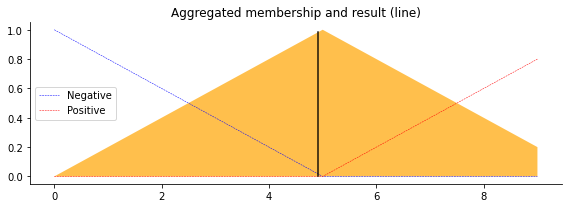

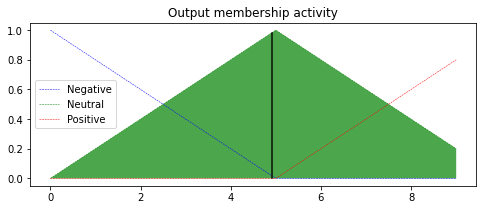

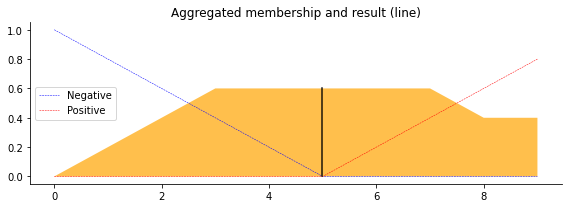

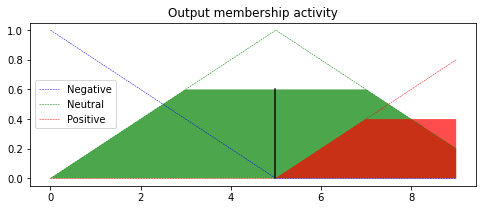

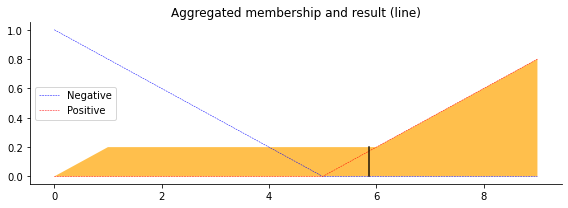

...

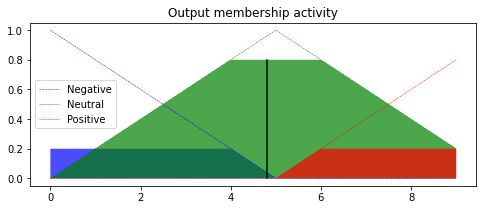

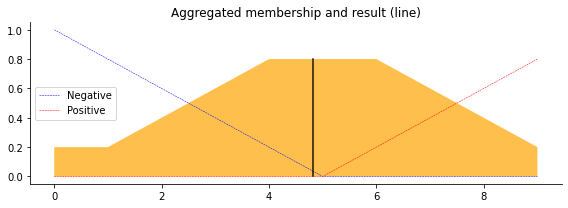

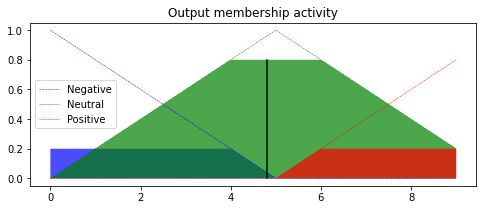

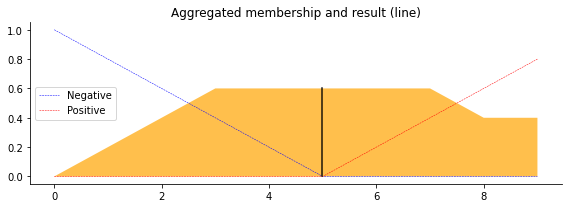

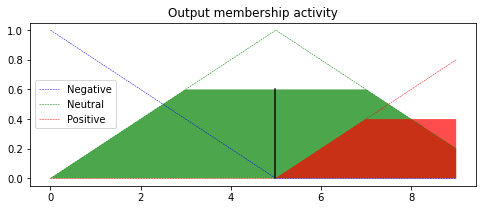

In [ ]:
for j in range(len(doc)):
  sentiment_doc.append(senti[j])
  ss = sid.polarity_scores(tweets[j])
  posscore=ss['pos']
  negscore=ss['neg']
  neuscore=ss['neu']
  compoundscore=ss['compound']

  print(str(j+1)+" {:-<65} {}".format(tweets[j], str(ss))) 

  print("\nPositive Score for each  tweet :")    
  if (posscore==1):
    posscore=0.9 
  else:
    posscore=round(posscore,1)
  print(posscore)

  print("\nNegative Score for each  tweet :")
  if (negscore==1):
    negscore=0.9
  else:
    negscore=round(negscore,1)
  print(negscore)

  # We need the activation of our fuzzy membership functions at these values.
  p_level_lo = fuzz.interp_membership(x_p, p_lo, posscore)
  p_level_md = fuzz.interp_membership(x_p, p_md, posscore)
  p_level_hi = fuzz.interp_membership(x_p, p_hi, posscore)

  n_level_lo = fuzz.interp_membership(x_n, n_lo, negscore)
  n_level_md = fuzz.interp_membership(x_n, n_md, negscore)
  n_level_hi = fuzz.interp_membership(x_n, n_hi, negscore)

  # Now we take our rules and apply them. Rule 1 concerns bad food OR nice.
  # The OR operator means we take the maximum of these two.
  active_rule1 = np.fmin(p_level_lo, n_level_lo)
  active_rule2 = np.fmin(p_level_md, n_level_lo)
  active_rule3 = np.fmin(p_level_hi, n_level_lo)
  active_rule4 = np.fmin(p_level_lo, n_level_md)
  active_rule5 = np.fmin(p_level_md, n_level_md)
  active_rule6 = np.fmin(p_level_hi, n_level_md)
  active_rule7 = np.fmin(p_level_lo, n_level_hi)
  active_rule8 = np.fmin(p_level_md, n_level_hi)
  active_rule9 = np.fmin(p_level_hi, n_level_hi)
    
  # Now we apply this by clipping the top off the corresponding output
  # membership function with `np.fmin`

  n1=np.fmax(active_rule4,active_rule7)
  n2=np.fmax(n1,active_rule8)     
  op_activation_lo = np.fmin(n2,op_Neg)

  neu1=np.fmax(active_rule1,active_rule5)
  neu2=np.fmax(neu1,active_rule9)     
  op_activation_md = np.fmin(neu2,op_Neu)

  p1=np.fmax(active_rule2,active_rule3)
  p2=np.fmax(p1,active_rule6)   
  op_activation_hi = np.fmin(p2,op_Pos)

  op0 = np.zeros_like(x_op)

  # Aggregate all three output membership functions together
  aggregated = np.fmax(op_activation_lo,
                       np.fmax(op_activation_md, op_activation_hi))
    
  # Calculate defuzzified result
  op = fuzz.defuzz(x_op, aggregated, 'centroid')
  output=round(op,2)

  op_activation = fuzz.interp_membership(x_op, aggregated, op)  # for plot

  # Visualize Aggregated Membership
  fig, ax0 = plt.subplots(figsize=(8, 3))
   
  ax0.plot(x_op, op_Neg, 'b', linewidth=0.5, linestyle='--',label= 'Negative')
  ax0.plot(x_op, op_Pos, 'r', linewidth=0.5, linestyle='--',label= 'Positive')
  ax0.fill_between(x_op, op0, aggregated, facecolor='Orange', alpha=0.7)
  ax0.plot([op, op], [0, op_activation], 'k', linewidth=1.5, alpha=0.9)
  ax0.set_title('Aggregated membership and result (line)')
  ax0.legend()

  # Turn off top/right axes
  for ax in (ax0,):
      ax.spines['top'].set_visible(False)
      ax.spines['right'].set_visible(False)
      ax.get_xaxis().tick_bottom()
      ax.get_yaxis().tick_left()

  plt.tight_layout()
    
  # Visualize Output Membership
  fig, ax0 = plt.subplots(figsize=(8, 3))

  ax0.fill_between(x_op, op0, op_activation_lo, facecolor='b', alpha=0.7)
  ax0.plot(x_op, op_Neg, 'b', linewidth=0.5, linestyle='--',label= 'Negative' )
  ax0.fill_between(x_op, op0, op_activation_md, facecolor='g', alpha=0.7)
  ax0.plot(x_op, op_Neu, 'g', linewidth=0.5, linestyle='--', label='Neutral')
  ax0.fill_between(x_op, op0, op_activation_hi, facecolor='r', alpha=0.7)
  ax0.plot(x_op, op_Pos, 'r', linewidth=0.5, linestyle='--', label='Positive')
  ax0.plot([op, op], [0, op_activation], 'k', linewidth=1.5, alpha=0.9)
  ax0.set_title('Output membership activity')
  ax0.legend()

#    # Turn off top/right axes
#    for ax in (ax0,):
#        ax.spines['top'].set_visible(False)
#        ax.spines['right'].set_visible(False)
#        ax.get_xaxis().tick_bottom()
#        ax.get_yaxis().tick_left()
#    
#    plt.tight_layout()       
       
  print("\nFiring Strength of Negative (wneg): "+str(round(n2,4)))
  print("Firing Strength of Neutral (wneu): "+str(round(neu2,4)))
  print("Firing Strength of Positive (wpos): "+str(round(p2,4)))

  print("\nResultant consequents MFs:" )
  print("op_activation_low: "+str(op_activation_lo))
  print("op_activation_med: "+str(op_activation_md))
  print("op_activation_high: "+str(op_activation_hi))

  print("\nAggregated Output: "+str(aggregated))

  print("\nDefuzzified Output: "+str(output))

# Scale : Neg Neu Pos   
  if 0<(output)<3.33:    # R
      print("\nOutput after Defuzzification: Negative")
      sentiment.append("Negative")
      
  elif 3.34<(output)<6.66:
      print("\nOutput after Defuzzification: Neutral")
      sentiment.append("Neutral")

  elif 6.67<(output)<10:
      print("\nOutput after Defuzzification: Positive")
      sentiment.append("Positive")
      
  print("Doc sentiment: " +str(senti[j])+"\n")    
    


## Evaluation

In [ ]:
count=0
for k in range(len(doc)):
    if(sentiment_doc[k]==sentiment[k]):
        count=count+1       
print("Accuracy is: "+ str(round(count/len(doc)*100,2)))

from sklearn.metrics import f1_score, precision_score, recall_score
y_true = sentiment_doc
y_pred = sentiment

p1=precision_score(y_true, y_pred, average='macro')  

print("Precision score (MACRO): " + str(round((p1*100),2)))

r1=recall_score(y_true, y_pred, average='macro')  

print("Recall score (MACRO): " + str(round((r1*100),2)))

f1=f1_score(y_true, y_pred, average='macro')  
f2=f1_score(y_true, y_pred, average='micro')  

print("F1 score (MACRO): " + str(round((f1*100),2)))
print("F1 score (MICRO): "+ str(round((f2*100),2)))

end = time.time()
print("Execution Time: "+str(round((end - start),3))+" secs")




Accuracy is: 50.3
Precision score (MACRO): 10.78
Recall score (MACRO): 19.53
F1 score (MACRO): 13.89
F1 score (MICRO): 50.3
Execution Time: 832.217 secs


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
from sklearn.metrics import accuracy_score
accuracy_score(y_true, y_pred)
accuracy_score(y_true, y_pred)

0.5030364372469636